<div style="width:100%; height:140px">
    <img src="https://www.kuleuven.be/internationaal/thinktank/fotos-en-logos/ku-leuven-logo.png/image_preview" width = 300px, heigh = auto align=left>
</div>  

# KUL H02A5a Computer Vision: Group Assignment 1
---


Group 1: 
* Kostantinos Gkentsidis,  [email](konstantinos.gkentsidis@student.kuleuven.be),  r0823033  

* Charalampos Kalavrytinos, [email](charalampos.kalavrytinos@student.kuleuven.be). r0833114  

* Georgios Kouros,  [email](georgios.kouros@student.kuleuven.be),  r0816917  

* Marios Makedon,  [email](marios.makedon@student.kuleuven.be), r0828881

* Foivos varthalitis,  [email](foivos.varthalitis@student.kuleuven.be), r0829517 


# 1. Overview
This assignment consists of the following sections:

1. Overview
2. Image classification 
3. Semantic segmentation 
4. Adversarial attacks 
5. Discussion

In the first part, we train an end-to-end neural network for image classification using a completely custom architecture, and transfer learning. In the second part, we do the same for semantic segmentation. 

In the final part, we build a GAN model in order to exploit the initial classification network. 

## 1.1 Import libraries


In [1]:
import numpy as np                      # import numpy library for ndarrays
import pandas as pd                     # import pandas for handling dataframes
from matplotlib import pyplot as plt    # for plots and figure generation

import cv2                              # opencv for handling images, processing etc.
import tensorflow.keras                            # standard keras
from tensorflow.keras.models import Sequential, Model          # some models from keras
from tensorflow.keras.layers import Input, Dense, Conv2D, Flatten, MaxPooling2D, Activation, Dropout
from tensorflow.keras.applications.vgg16 import VGG16
from IPython.utils import io            # suppress output in the notebook during installations

from tqdm.notebook import tqdm          # progression bar for notebooks
import tensorflow as tf                 # import tensorflow as well

# Forces incremental memory allocation
physical_devices = tf.config.list_physical_devices('GPU')
try:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
except:
    pass                                # Invalid device or cannot modify virtual devices once initialized.

## 1.2 PASCAL VOC 2009
For this project we were requested to be using the [PASCAL VOC 2009](http://host.robots.ox.ac.uk/pascal/VOC/voc2009/index.html) dataset. This dataset consists of colour images of various scenes with different object classes (e.g. animal: *bird, cat, ...*; vehicle: *aeroplane, bicycle, ...*), totalling 20 classes. The Pascal VOC dataset is quite popular for the tasks of image classification, segmentation and object detection. We note that the provided images are only one small partition of the actual dataset.  



The training set contains 749 examples.


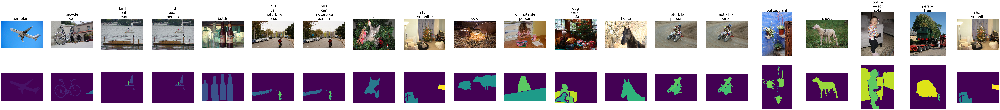

In [2]:
# Loading the training data
train_df = pd.read_csv('/kaggle/input/kul-h02a5a-computervision-groupassignment1/train/train_set.csv', index_col="Id")
labels = train_df.columns
train_df["img"] = [np.load('/kaggle/input/kul-h02a5a-computervision-groupassignment1/train/img/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
train_df["seg"] = [np.load('/kaggle/input/kul-h02a5a-computervision-groupassignment1/train/seg/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
print("The training set contains {} examples.".format(len(train_df)))

# Show some examples
fig, axs = plt.subplots(2, 20, figsize=(10 * 20, 10 * 2))
for i, label in enumerate(labels):
    df = train_df.loc[train_df[label] == 1]
    axs[0, i].imshow(df.iloc[0]["img"], vmin=0, vmax=255)
    axs[0, i].set_title("\n".join(label for label in labels if df.iloc[0][label] == 1), fontsize=40)
    axs[0, i].axis("off")
    axs[1, i].imshow(df.iloc[0]["seg"], vmin=0, vmax=20)  # with the absolute color scale it will be clear that the arrays in the "seg" column are label maps (labels in [0, 20])
    axs[1, i].axis("off")
    
plt.show()

In [3]:
# Loading the test data
test_df = pd.read_csv('/kaggle/input/kul-h02a5a-computervision-groupassignment1/test/test_set.csv', index_col="Id")
test_df["img"] = [np.load('/kaggle/input/kul-h02a5a-computervision-groupassignment1/test/img/test_{}.npy'.format(idx)) for idx, _ in test_df.iterrows()]
test_df["seg"] = [-1 * np.ones(img.shape[:2], dtype=np.int8) for img in test_df["img"]]
print("The test set contains {} examples.".format(len(test_df)))

The test set contains 750 examples.


## 1.3 Kaggle submission
The final filled test dataframe is converted to a submission.csv with two rows per example (one for classification and one for segmentation) and with only a single prediction column (the multi-class/label predictions running length encoded).

In [4]:
def _rle_encode(img):
    """
    Kaggle requires RLE encoded predictions for computation of the Dice score (https://www.kaggle.com/lifa08/run-length-encode-and-decode)

    Parameters
    ----------
    img: np.ndarray - binary img array
    
    Returns
    -------
    rle: String - running length encoded version of img
    """
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    rle = ' '.join(str(x) for x in runs)
    return rle

def generate_submission(df):
    """
    Make sure to call this function once after you completed Sect. 2 and Sect. 3! It transforms and writes your test dataframe into a submission.csv file.
    
    Parameters
    ----------
    df: pd.DataFrame - filled dataframe that needs to be converted
    
    Returns
    -------
    submission_df: pd.DataFrame - df in submission format.
    """
    df_dict = {"Id": [], "Predicted": []}
    for idx, _ in df.iterrows():
        df_dict["Id"].append(f"{idx}_classification")
        df_dict["Predicted"].append(_rle_encode(np.array(df.loc[idx, labels])))
        df_dict["Id"].append(f"{idx}_segmentation")
        df_dict["Predicted"].append(_rle_encode(np.array([df.loc[idx, "seg"] == j + 1 for j in range(len(labels))])))
    
    submission_df = pd.DataFrame(data=df_dict, dtype=str).set_index("Id")
    submission_df.to_csv("submission.csv")
    return submission_df

# 2. Image classification
The goal here is simple: implement a classification CNN and train it to recognise all 20 classes (without background) using the training set and compete on the test set (by filling in the classification columns in the test dataframe).  
In this step we convert the dataframes to arrays for training and testing sets, and then use the sci-kit learn package in order to split to train and validation sets with a ~20% images for validation.

In [5]:
train_y_df = train_df[labels]             # get train labels
train_y_arr = np.array(train_y_df)        # convert to array

# Resize all images to 224x224 since it is the desired image size for VGG16
train_X_list = [cv2.resize(train_df["img"].loc[i], (224,224)) for i in range(len(train_df))]
train_X_arr = np.stack(train_X_list, axis=0)                # add them all to a new axis

test_y_df = test_df[labels]               # get test labels (-1)
test_y_arr = np.array(test_y_df)          # convert to array

# Resize all images to 224x224 since it is the desired image size for VGG16
test_X_list = [cv2.resize(test_df["img"].loc[i], (224,224)) for i in range(len(test_df))]
test_X_arr = np.stack(test_X_list, axis=0)                # add them all to a new axis
test_X = test_X_arr
test_X_arr.shape                                          # have a 750x224x224x3 ndarray

print(f'Test samples: {test_X_arr.shape[0]}')             # have a 750x224x224x3 ndarray

Test samples: 750


In [6]:
# We don't consider background as class 0 for the classification task
CAT_LIST = ['aeroplane', 'bicycle', 'bird', 'boat',
        'bottle', 'bus', 'car', 'cat', 'chair',
        'cow', 'diningtable', 'dog', 'horse',
        'motorbike', 'person', 'pottedplant',
        'sheep', 'sofa', 'train',
        'tvmonitor']

## Resizing images
Resizing images is a critical preprocessing step in computer vision since all the Convolutional Neural Network architectures require samples of the same size. In our case, we resized all the raw images to a fixed size of $224 x 224 x 3$. 

In [7]:
from sklearn.model_selection import train_test_split    

# Just split train and val dataset
train_X_list = [cv2.resize(train_df["img"].loc[i], (224,224)) for i in range(len(train_df))]
train_X_arr = np.stack(train_X_list, axis=0)

train_X, val_X, train_y, val_y = train_test_split(train_X_arr, train_y_arr, test_size=0.2,random_state=12)

In [8]:
ntrain = train_X.shape[0]     # number of train samples
nval = val_X.shape[0]         # number of val samples
ntest = test_X_arr.shape[0]   # number of test samples

print('Number of training samples:', ntrain)
print('Number of validation samples:', nval)
print('Number of test samples:', ntest)

Number of training samples: 599
Number of validation samples: 150
Number of test samples: 750


## Data exploratory analysis via inspection
In order to have some insight of the dataset, we  plot some interesting metrics (i.e. the amount of samples for each class, training and validation sets). We observe the classes are severely imbalanced since there is a large amount of images in 'person' class, and much fewer observations for the rest of the classes. Training CNNs on an imbalanced dataset can introduce unique challenges to the learning process. One of them, is the so called frequency bias problem where they place more emphasis on learning data that occur more often.

<BarContainer object of 20 artists>

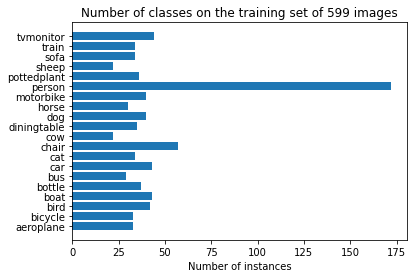

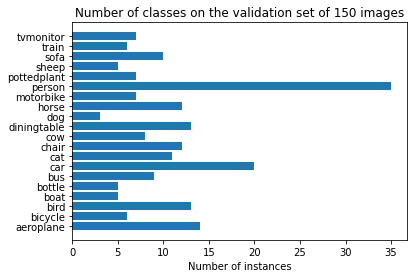

In [9]:
plt.figure()
plt.title(f'Number of classes on the training set of {ntrain} images')
plt.xlabel('Number of instances')
plt.barh(CAT_LIST,train_y.sum(axis=0))

plt.figure()
plt.title(f'Number of classes on the validation set of {nval} images')
plt.xlabel('Number of instances')
plt.barh(CAT_LIST,val_y.sum(axis=0))

One of the simplest ways to address this class imbalance is to simply provide a weight for each class which places more emphasis on the minority classes such that the end result is a classifier which can learn equally from all classes. The following weights were decided heuristically.

Text(0.5, 1.0, 'class weights')

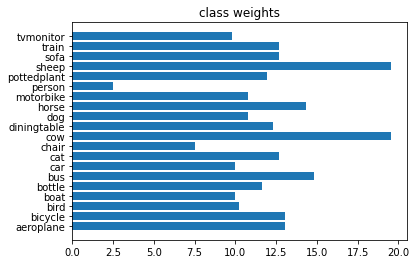

In [10]:
class_weights = [((1 / element)*(np.sum(train_y.sum(axis=0)))/2.0) for element in train_y.sum(axis=0)]
plt.barh(CAT_LIST, class_weights)
plt.title('class weights')

## Model evaluation
When dealing with imbalanced data, standard metrics such as the accuracy score do not adequately represent model performance. The reason is that they are heavily biased towards to the classes with the most images. A suitable measure for classification models with imbalanced data is the $F_{1}$ metric and it is defined as the harmonic average of the precision and recall:

\begin{equation}
F_{1} = \dfrac{2TP}{2TP+ FP+ FN}
\end{equation}

where TP, FN correspond to the number of true positives and false negatives respectively.

In [11]:
"""Define some metrics"""
from tensorflow.keras import backend as K

def recall_custom(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_custom(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_custom(y_true, y_pred):
    precision = precision_custom(y_true, y_pred)
    recall = recall_custom(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

## 2.1. Custom CNN for classification on VOC 2009
In this section we constructed the following custom CNN model with Keras.

**Assumptions:** We consider the 20 classes to be independent of each other and so we use the **binary cross entropy** loss function. This is not strictly true, since there are **correlations** among some classes i.e. class `'boat'` tends to not be present with other classes like `'tvmonitor'`, 'sofa' etc. Due to the fairly limited number of images for training a deep learning model, we use data augmentation with the `ImageDataGenerator` class of keras. The maximum number of epochs is set to 500, but early stopping monitoring the validation loss with a patience of X epochs is also utilized. We also use checkpoints in order to save the best model after epoch training and a learning rate that drops a scale after it hits a plateau (N epochs). The batch size is set to 32.

**The Architectures:** First, we use a fairly shallow architecture with convolutional layers with increasing number of filters and $ReLu$ activation functions, with alternating Max pooling layers between them. We then simply flatten the output and feed it to a $Dense$ layer of 128 neurons. Then, we insert a dropout of $20%$ for regularization and another dense layer with 20 neurons for the 20 classes of the `VOC dataset`. At the end, we use the sigmoid function in order to be able to extract the probabilities of each class.  

We decide on this architecture having the low amount of learning parameters in mind. 

In [12]:
# Import necessary libraries from keras
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Flatten, Dense, Dropout, Conv2D, MaxPooling2D, ZeroPadding2D, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.regularizers import l2


class Img_cls_from_scratch:
    """Train custom CNN from scratch"""
    def __init__(self, batch_size=32, ep=500):
        self.batch_size = batch_size                  # batch size, default: 32
        self.nepochs = ep                             # number of epochs, default: 500 (also using early stopping)
        self.optim = Adam(learning_rate=1e-2)         # classic Adam optimizer
        self.loss = keras.losses.BinaryCrossentropy(from_logits=True) # Binary cross entropy since classes are independent

        # Make typical model architecture
        modl = Sequential()
        modl.add(Conv2D(32, (3, 3), input_shape=(224, 224,3)))
        modl.add(Activation('relu'))
        modl.add(MaxPooling2D(pool_size=(2, 2)))
        modl.add(Conv2D(32, (3, 3)))
        modl.add(Activation('relu'))
        modl.add(MaxPooling2D(pool_size=(2, 2)))
        modl.add(Conv2D(64, (3, 3)))
        modl.add(Activation('relu'))
        modl.add(MaxPooling2D(pool_size=(2, 2)))
        
        modl.add(Flatten())
        modl.add(Dense(128, kernel_regularizer=l2(0.001), bias_regularizer=l2(0.001)))
        modl.add(Activation('relu'))
        modl.add(Dropout(0.2))
        modl.add(Dense(20))
        modl.add(Activation('sigmoid'))
        self.model = modl
        
        met = [ keras.metrics.BinaryAccuracy(name='binary_accuracy'),
                keras.metrics.AUC(name='auc'),
                keras.metrics.AUC(name='prc', curve='PR')
              ]


        self.model.compile(loss=self.loss, optimizer=self.optim, metrics=met)

        # Create data generators for training and validation sets utilizing image augmentation
        self.train_datagen = ImageDataGenerator(rotation_range=40,
                                            width_shift_range=0.2,
                                            height_shift_range=0.2,
                                            rescale=1./255,
                                            shear_range=0.2,
                                            zoom_range=0.2,
                                            horizontal_flip=True,
                                            fill_mode='nearest')
        
        self.val_datagen = ImageDataGenerator(rescale=1./255)
    
    
    def train(self, x_train, y_train, x_val, y_val):
        """Trains the model"""
        ntrain = x_train.shape[0]           # train samples
        nval = x_val.shape[0]               # val samples

        train_gen = self.train_datagen.flow(x_train, y_train, batch_size=self.batch_size)
        val_gen = self.val_datagen.flow(x_val, y_val, batch_size=self.batch_size, shuffle=False)

        # Use checkpoints to save and restore best models
        checkpoint = ModelCheckpoint('custom_cls.h15',
                                        monitor='val_loss',
                                        mode='min',
                                        save_best_only=True,
                                        verbose=1)
        
        # Use early stopping for training optimization
        earlystop = EarlyStopping(monitor='val_loss',
                                        min_delta=0,
                                        patience=36,
                                        verbose=1,
                                        restore_best_weights=True)
        # Use adaptive lr based on plateau (after 50 epochs drops lr 1 scale)
        rlrop = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=16)

        # Actually train the model
        self.history = self.model.fit(train_gen,
                                    epochs=self.nepochs,
                                    steps_per_epoch=ntrain // self.batch_size,
                                    validation_data=val_gen,
                                    validation_steps=nval // self.batch_size,
                                    callbacks=[rlrop, earlystop, checkpoint],
                                    class_weight=dict(enumerate(class_weights))
                                    )

    def predict(self, test_X):
        test_gen = self.val_datagen.flow(test_X, batch_size=32, shuffle=False)
        return self.model.predict(test_gen)
        
    def __call__(self, X):
        return self.predict(X)

## Train custom CNN

In [13]:
train_X.shape

(599, 224, 224, 3)

In [14]:
# Change to nd arrays
train_X = np.asarray(train_X)
train_y = np.asarray(train_y)
val_X = np.asarray(val_X)
val_y = np.asarray(val_y)

In [15]:
# Train custom image classifier
# custom_classifier = Img_cls_from_scratch()

# custom_classifier.train(train_X,train_y, val_X, val_y)
# custom_classifier.model.save('custom_cls.h5')

Training and Validation Loss and Accuracy For custom classification model.

<img align="left"  src="https://i.imgur.com/zlHeLRR.png">
<img align="left"  src="https://i.imgur.com/itkWXxX.png">


## 2.2. Classification based on transfer-learning  
We expected our custom classification model to perform suboptimally, since it requires a lot of data and time in order to yield adequate results when training a neural network from scratch, especially for multi-label classification. Instead, we use some popular deep learning architectures with pre-trained weights on larger datasets (i.e. ImageNet) in order to speed up the process. We experimented with two different models with different architectures and backbones. The first architecture contains an `Xception` backbone and the second architecture is a basic `VGG16 pretrained on imagenet`. 

Data augmentation proved again vital to increase performance even for the pretrained networks.

### 2.2.a. Model based on Xception net pretrained on ImageNet

[Xception](https://arxiv.org/abs/1610.02357) is a state-of-the-art neural network architecture developed by François Chollet. The architecture is inspired by inception-module-based architectures but instead of inception modules it contains depthwise separable convolutions. Inception and depthwise separable convolutions are generally more successful in reducing computational expense and prevent overfitting than other simpler architectures.

We trained an ImageNet-pretrained Xception net on the PASCAL VOC 2009 dataset for around 45 epochs using Stochastic Gradient Descent and a binary crossentropy loss function since we use one-hot-encoded label vectors. We also used data augmentation to improve the ability of the network to generalize and to prevent overfitting.

![Xception_architecture.png](https://miro.medium.com/max/833/1*t6qfo9ucYza_lbLfg5-p_w.png)

In [16]:
from tensorflow.keras.applications import Xception
from tensorflow.keras import models, layers
from tensorflow.keras.callbacks import EarlyStopping, History, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.metrics import Precision, Recall
from tensorflow_addons.metrics import F1Score
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.utils.vis_utils import plot_model


def get_transfer_learning_model():
  """ Function that downloads and modifies a standard xception model"""
  input_shape = (224,224,3)
  base_model = Xception(include_top=False, input_shape=input_shape, weights='imagenet')
  output = base_model.layers[-1].output
  output = layers.Flatten()(output)
  base_model = Model(inputs=base_model.input, outputs=output)

  for layer in base_model.layers:
      layer.trainable = False

  # Add new layers on top
  transfer_learning_model = models.Sequential()
  transfer_learning_model.add(base_model)
  transfer_learning_model.add(layers.Dense(512, activation='relu', input_dim=input_shape))
  transfer_learning_model.add(layers.Dropout(0.3))
  transfer_learning_model.add(layers.Dense(512, activation='relu'))
  transfer_learning_model.add(layers.Dropout(0.3))
  transfer_learning_model.add(layers.Dense(units=20, activation='sigmoid'))

  return transfer_learning_model


# Get the Xception based model
transfer_learning_model = get_transfer_learning_model()

thresholds = [0.3,0.4,0.5,0.6,0.7,0.8,0.9]
transfer_learning_model.compile(loss='binary_crossentropy', optimizer="sgd", metrics=[F1Score(20), Precision(thresholds=thresholds), Recall(thresholds=thresholds)])

batch_size = 64

# Use ImageDataGenerator for rescaling and data augmentation
val_datagen = ImageDataGenerator(rescale=1./255,
  featurewise_center=True,
  featurewise_std_normalization=True
)

train_datagen = ImageDataGenerator(rescale=1./255,
                                   featurewise_center=True,
                                   featurewise_std_normalization=True,
                                   rotation_range=10,
                                   width_shift_range=0.1,
                                   height_shift_range=0.1,
                                   shear_range=0.1,
                                   zoom_range=0.1,
                                   horizontal_flip=True,
)

train_datagen.fit(train_X)
val_datagen.fit(train_X)

train_gen = train_datagen.flow(train_X, train_y, batch_size=batch_size)
val_gen = val_datagen.flow(val_X, val_y, batch_size=batch_size, shuffle=False)
num_epochs = 45
callbacks = [
  ModelCheckpoint('Xception', monitor='val_loss', save_best_only=True),
  ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, verbose=1, min_lr=1e-4),
  EarlyStopping(monitor="val_loss", patience=15), History(),
]

# train the model
if False:
  transfer_learning_history = transfer_learning_model.fit(x=train_gen,
                              validation_data=val_gen,
                              epochs=100,
                              verbose=1,
                              class_weight=dict(enumerate(class_weights)),
                              callbacks=callbacks)

83689472/83683744 [==============================] - 0s 0us/step


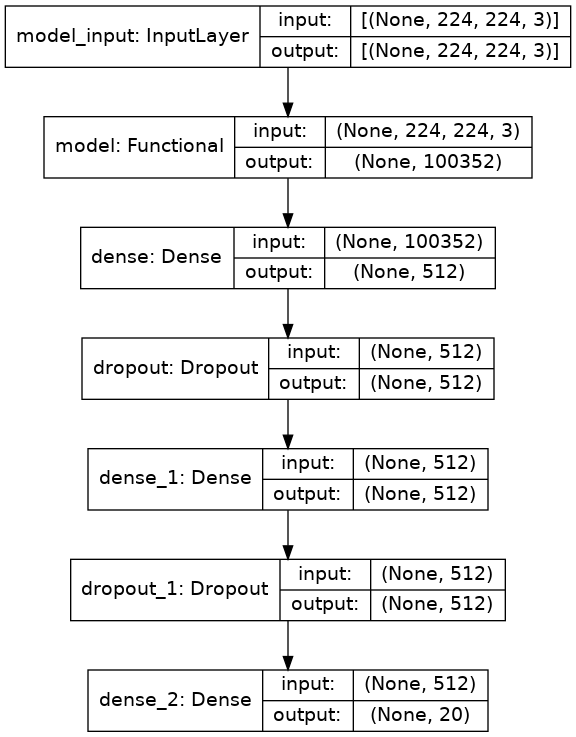

In [17]:
plot_model(transfer_learning_model, show_shapes=True, show_layer_names=True)

In [18]:
""" get predictions for test data"""
# test_df.loc[:, "seg"] = model.predict(test_df["img"])
# test_gen = val_datagen.flow(test_X_arr, test_y_arr, batch_size=64, shuffle=False)
# pred_y = model.predict(test_gen)

# pred_y2 = pred_y > 0.4
# test_df.loc[:, labels] = pred_y2.astype(int)

# """ Generate submission file """
# generate_submission(test_df)

' get predictions for test data'

In [19]:
# ii=570
# plt.figure()
# plt.imshow(test_X_arr[ii], cmap='gray')
# plt.figure()
# plt.barh(CAT_LIST, pred_y[ii])

### Plot loss per epoch for training and validation set

In [20]:
if False:
    print(transfer_learning_model.history.history.keys())
    plt.figure()
    plt.plot(transfer_learning_model.history.history['loss'])
    plt.plot(transfer_learning_model.history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

    #plt.plot(transfer_learning_model.history.history['lr'])
    #plt.title('Learning rate')

### 2.2.b. Model based on VGG16 pre-trained on 'ImageNet' 

A plethora of Convolutional Neural Network architectures already exist for image classification. For this reason, we can use a pretrained  model as a starting point and retrain it on our dataset. In this assignment we used a $VGG16$ model for transfer learning. $VGG16$ was proposed by _K. Simonyan _and _A. Zisserman_ from the University of Oxford in the paper  [“Very Deep Convolutional Networks for Large-Scale Image Recognition”](https://arxiv.org/abs/1409.1556). The model achieved $92.7%$ test accuracy in $ImageNet$, which is a dataset of over 14 million images belonging to 1000 classes.
![](https://neurohive.io/wp-content/uploads/2018/11/vgg16-1-e1542731207177.png)


In this section we use the following class in order to download a pre-trained VGG16 model without its final layers.  

**Assumptions:** We continue with the same assumptions as before, and similar image augmentation but this time we set the maximum number of epochs to $500$ since we expect the model to converge much faster than before.

**The Process:** At first, we freeze all layers of the pre-trained VGG16 and then add a few on top. We start by training the weights of only the new top layers with the same training and validation sets as before. After convergence, we then unfreeze the whole model and fine-tune it with a very low learning rate and the $Adam$ optimizer for a mere 10 epochs in order to achieve some incremental improvement.

In [21]:
from tensorflow import keras

class Img_cls_fine_tuned:
    def __init__(self, batch_size=32, ep=500, num_classes=20):
      self.batch_size = batch_size                                        # batch size
      self.nepochs = ep                                                   # number of maximum epochs
      self.optim = Adam(learning_rate=1e-2)                               # use Adam with higher lr
      self.loss = keras.losses.BinaryCrossentropy(from_logits=True)       # Binary cross entropy since classes are independent

      # Download VGG16 pretrained on 'ImageNet' without top layers
      self.base_model = VGG16(include_top=False,
                      weights="imagenet")
      
      self.base_model.trainable = False                     # freeze the layers at first
      inputs = Input(shape=(224, 224, 3))                   # input image size
      x = self.base_model(inputs, training=False)
      x = GlobalAveragePooling2D()(x)
      x = Dropout(0.2)(x)
      x = Dense(1024, activation='relu')(x)
      outputs = Dense(num_classes, activation='sigmoid')(x)

      # Build model
      self.model = Model(inputs, outputs)
      metrics_tmp = [ keras.metrics.BinaryAccuracy(name='binary_accuracy'),
                keras.metrics.AUC(name='auc'),
                keras.metrics.AUC(name='prc', curve='PR'),
                precision_custom,
                recall_custom,
                f1_custom
              ]
    
      # Compile model
      self.model.compile(loss=self.loss, optimizer=self.optim, metrics=metrics_tmp)
      
      self.train_datagen = ImageDataGenerator(rotation_range=40,
                                    width_shift_range=0.2,
                                    height_shift_range=0.2,
                                    rescale=1./255,
                                    shear_range=0.2,
                                    zoom_range=0.2,
                                    horizontal_flip=True,
                                    fill_mode='nearest')
        
      self.val_datagen = ImageDataGenerator(rescale=1./255)
        
  

    def train(self, x_train, y_train, x_val, y_val):
      """Trains model"""
      ntrain = x_train.shape[0]       # train samples   
      nval = x_val.shape[0]           # val samples

      train_gen = self.train_datagen.flow(x_train, y_train, batch_size=self.batch_size)         # make generator for train
      val_gen = self.val_datagen.flow(x_val, y_val, batch_size=self.batch_size, shuffle=False)  # make generator for val

      # Keep checkpoints for saving and restoring models
      checkpoint = ModelCheckpoint('vgg16_cls.h15',
                                      monitor='val_loss',
                                      mode='min',
                                      save_best_only=True,
                                      verbose=1)
      # Early stopping (with small patience since now model does not train from scratch)
      earlystop = EarlyStopping(monitor='val_loss',
                                      min_delta=0,
                                      patience=24,
                                      verbose=1,
                                      restore_best_weights=True)
      # adaptive lr (same as previous class)
      rlrop = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=16)

      # Actually train the model
      self.hist1 = self.model.fit(train_gen,
                                  epochs=self.nepochs,
                                  steps_per_epoch=ntrain // self.batch_size,
                                  validation_data=val_gen,
                                  validation_steps=nval // self.batch_size,
                                  callbacks=[rlrop, earlystop, checkpoint],
                                  class_weight=dict(enumerate(class_weights))

                                  )
      # Now unfreeze the base model and fine tune it for a few epochs with very low lr
      self.base_model.trainable = True
      self.model.compile(
          optimizer=keras.optimizer.Adam(1e-5),  # Low learning rate
          loss=keras.losses.BinaryCrossentropy(from_logits=True),
          metrics=[keras.metrics.BinaryAccuracy()],
      )
      # Train the model a second time
      self.hist2 = self.model.fit(train_gen, epochs=8, validation_data=val_gen, callbacks=[checkpoint])

    def predict(self, test_X):
        test_gen = self.val_datagen.flow(test_X, batch_size=32, shuffle=False)
        return self.model.predict(test_gen)
        
    def __call__(self, X):
        return self.predict(X)

### Fine tune a VGG16 model for VOC classification

In [22]:
vgg16_ft_class = Img_cls_fine_tuned()
# vgg16_ft_class.train(train_X, train_y, val_X, val_y)
# vgg16_ft_class.model.save('vgg16_ft.h5')

58892288/58889256 [==============================] - 0s 0us/step


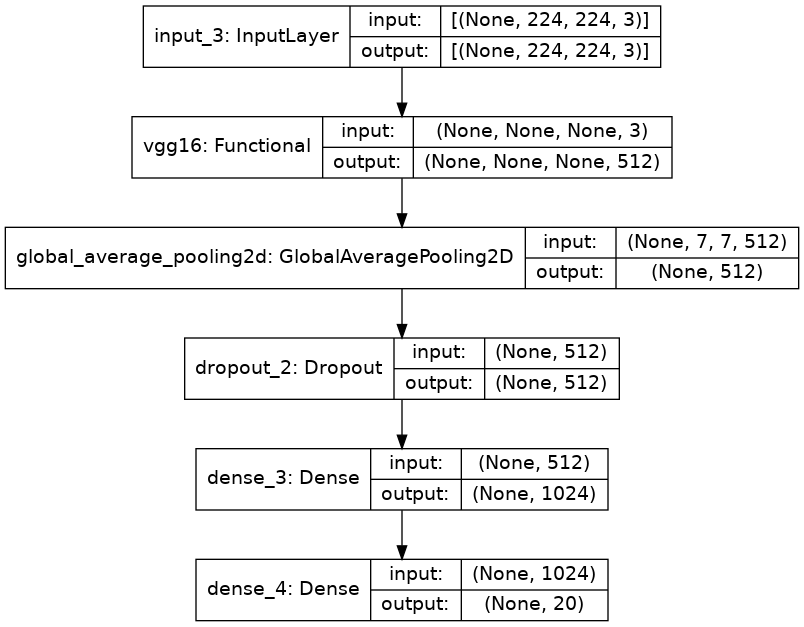

In [23]:
plot_model(vgg16_ft_class.model, show_shapes=True, show_layer_names=True)

### Plot loss per epoch for training and validation sets

In [24]:
if False:
    print(vgg16_ft_class.hist1.history.keys())
    # summarize history for accuracy
    plt.plot(vgg16_ft_class.hist1.history['binary_accuracy'])
    plt.plot(vgg16_ft_class.hist1.history['val_binary_accuracy'])
    plt.title('VGG16 classification accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()
    # summarize history for loss
    plt.plot(vgg16_ft_class.hist1.history['loss'])
    plt.plot(vgg16_ft_class.hist1.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

In [25]:
if False:
    plt.plot(vgg16_ft_class.hist2.history['binary_accuracy'])
    plt.plot(vgg16_ft_class.hist2.history['val_binary_accuracy'])
    plt.title('VGG16 classification accuracy (fine tuning phase)')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()
    # summarize history for loss
    plt.plot(vgg16_ft_class.hist2.history['loss'])
    plt.plot(vgg16_ft_class.hist2.history['val_loss'])
    plt.title('model loss (fine tuning phase)')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

## Check some qualitative results of 'train' set with the actual labels

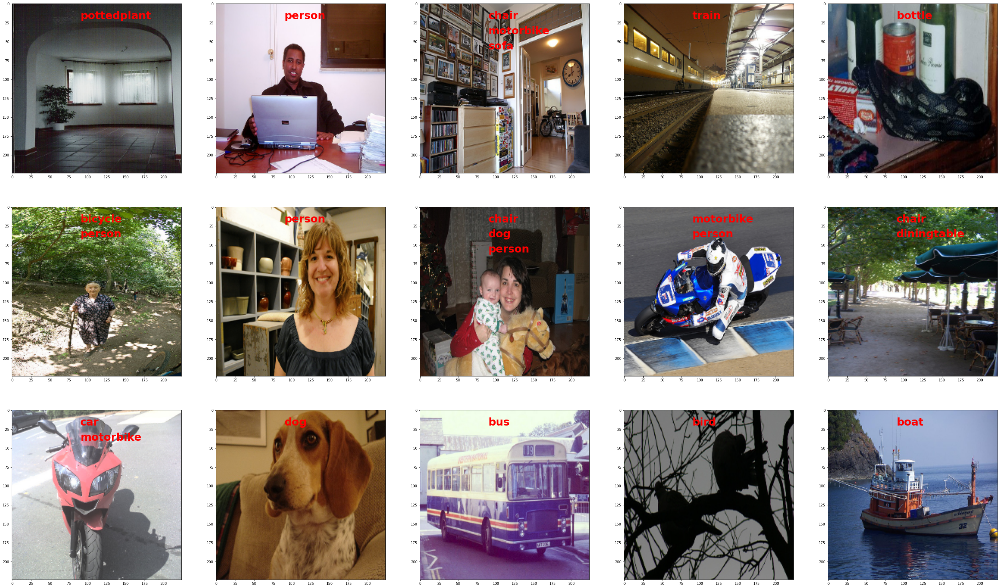

In [26]:
# Print a few training images with the actual labels
imgs_per_row = 5          # plot 5 imgs per row
n = 15
n_rows = round(n/imgs_per_row)

f, ax = plt.subplots(n_rows, imgs_per_row, figsize=(10*imgs_per_row,10*n_rows))
for i in range(n):
  ax[int(i/imgs_per_row),int(i%imgs_per_row)].imshow(train_X[i])
  ii=20
  for item in np.argwhere(train_y[i] == np.max(train_y[i])):
      ax[int(i/imgs_per_row),int(i%imgs_per_row)].text(90,ii,CAT_LIST[item[0]], color='r', fontsize=30, weight='bold')
      
      ii=ii+20

### Load saved models for predictions  
Download already trained models stored in our google drive for convenience

In [27]:
# with io.capture_output() as captured:
!pip install gdown

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for gdown: filename=gdown-3.13.0-py3-none-any.whl size=9034 sha256=dc64f5ad25544833823ac8f719dd635aea5cc16936fd945d6bf1a46b52221413
  Stored in directory: /root/.cache/pip/wheels/2f/2a/2f/86449b6bdbaa9aef873f68332b68be6bfbc386b9219f47157d
Successfully built gdown


In [28]:
!gdown https://drive.google.com/uc?id=18kyduxArtCQlQilzeiQQkyXAs3jffQEb    # download vgg16_ft.zip
!gdown https://drive.google.com/uc?id=1CgVgTPQWfuJo7P07RBdPCot2KA0FF-nz    # download xception
!gdown https://drive.google.com/uc?id=1zb9IXTDZB0bKZZ00gb3ye3ucHkelweKx    # download custom_cls.zip
!gdown https://drive.google.com/uc?id=1ke9drRZuWRtEpMPdlvIe3jgFJzLLK-uA    # download unet
!gdown https://drive.google.com/uc?id=1ORnHb5RbGARbLmASx6APeYTpLnwB51N3    # download unet history
!gdown https://drive.google.com/uc?id=189aIJrh-XWAeefZEsKRmajSY-ZUX6R8j    # download fpn

# extract
!unzip -q vgg16_ft.zip
!unzip -q custom_cls.zip
!unzip -q fpn_seg_ft.zip

# remove zips
!rm -rf vgg16_ft.zip
!rm -rf custom_cls.zip
!rm -rf fpn_seg_ft.zip

Downloading...
From: https://drive.google.com/uc?id=18kyduxArtCQlQilzeiQQkyXAs3jffQEb
To: /kaggle/working/vgg16_ft.zip
167MB [00:00, 237MB/s]
Downloading...
From: https://drive.google.com/uc?id=1CgVgTPQWfuJo7P07RBdPCot2KA0FF-nz
To: /kaggle/working/Xception.h5
290MB [00:01, 219MB/s]
Downloading...
From: https://drive.google.com/uc?id=1zb9IXTDZB0bKZZ00gb3ye3ucHkelweKx
To: /kaggle/working/custom_cls.zip
62.9MB [00:00, 110MB/s]
Downloading...
From: https://drive.google.com/uc?id=1ke9drRZuWRtEpMPdlvIe3jgFJzLLK-uA
To: /kaggle/working/unet.h5
8.42MB [00:00, 154MB/s]
Downloading...
From: https://drive.google.com/uc?id=1ORnHb5RbGARbLmASx6APeYTpLnwB51N3
To: /kaggle/working/unet_history.csv
100%|██████████████████████████████████████| 36.1k/36.1k [00:00<00:00, 46.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=189aIJrh-XWAeefZEsKRmajSY-ZUX6R8j
To: /kaggle/working/fpn_seg_ft.zip
93.0MB [00:00, 239MB/s]


In [29]:
def multiple2single_one_hot_encoding(data_y, pred_y):
  """Takes truth and predicted labes and splits 1 hot encodings
      e.g.  data_y = [[1,0,0,1],[0,0,1,0]]
            pred_y = [[1,0,0,0],[1,0,1,0]]

      gives: 
            s_data = [[1,0,0,0,0],
                      [0,0,0,1,0],
                      [0,0,1,0,0]
                      [0,0,0,0,1]]
            s_pred = [[1,0,0,0,0],
                      [0,0,0,0,1],
                      [0,0,1,0,0],
                      [1,0,0,0,0]]
      where we introduce an extra class on the end 'missing' that indicates that the class was not found by our model
  """
  # get predictions of probabilities based on a threshold
  pred_y2 = pred_y
  pred_y2[pred_y > 0.2] = 1
  pred_y2[pred_y<=0.2] = 0       # now pred_y2 is binary

  separated_true = []             # keep true labels
  separated_pred = []             # keep predicted labels

  for i in range(data_y.shape[0]):
      t1 = np.argwhere(data_y[i] == 1).flatten()          # find indexes where there is 1
      t2 = np.argwhere(pred_y2[i] == 1).flatten()
      
      for el in np.argwhere(data_y[i] == 1).flatten():    # for each class found on data_y, construct separate 1-hot-encodings
        vec1 = np.zeros(data_y[0].shape[0]+1)             # init targets to zeroes
        vec2 = np.zeros(data_y[0].shape[0]+1)
        vec1[el] = 1                                      # take the index and make it 1
        if pred_y2[i][el]==1:
            vec2[el] = 1                                  # for the corresponding pred_y keep it as is
        else:
            vec2[20] = 1
        separated_true.append(vec1)                       # append to new list
        separated_pred.append(vec2)
        try:
          t2 = t2[t2 != el]                               # if same class found on both, then remove it from the t2 array
        except:
          pass
      for el in t2:                                       # take what's left from the pred_y and do the same
        vec1 = np.zeros(data_y[0].shape[0]+1)             # init targets to zeroes
        vec2 = np.zeros(data_y[0].shape[0]+1)
        if data_y[i][el] == 1:
            vec1[el] = 1
        else:
            vec1[20] = 1
        vec2[el] = 1
        separated_true.append(vec1)
        separated_pred.append(vec2)
  
  return separated_pred, separated_true


## Check custom classification model results

In [30]:
model0 = keras.models.load_model('custom_cls')                               # load custom cls model
test_datagen = ImageDataGenerator(rescale=1./255)                            # make test data generator

train_gen0 = test_datagen.flow(train_X, batch_size=32, shuffle=False)
test_gen0 = test_datagen.flow(test_X, batch_size=32, shuffle=False)
val_gen0 = test_datagen.flow(val_X, batch_size=32, shuffle=False)

pred_y0 = model0.predict(train_gen0)
pred_val_y0 = model0.predict(val_gen0)
# print(pred_y0[0])
# print(pred_y0[1])
# test_y = model0.predict(test_gen0)

In [31]:
s_pred0, s_true0 = multiple2single_one_hot_encoding(val_y, pred_val_y0)

## Visualization of the prediction scores

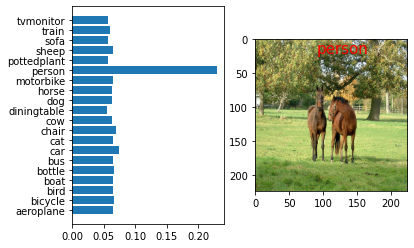

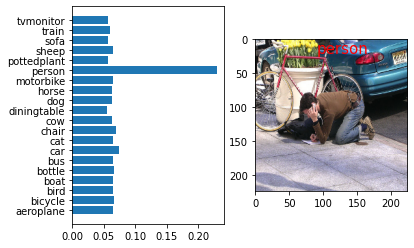

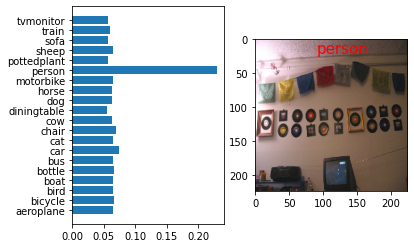

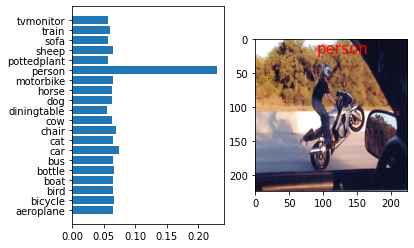

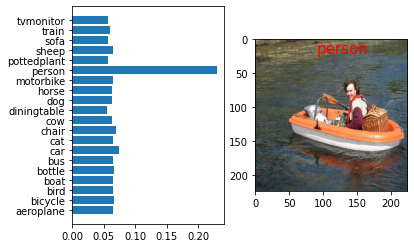

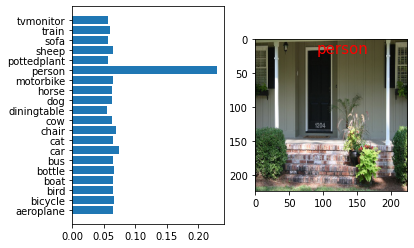

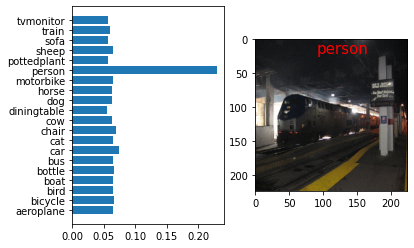

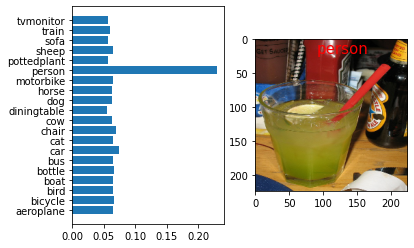

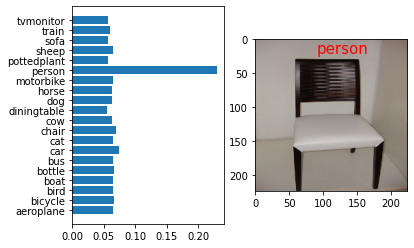

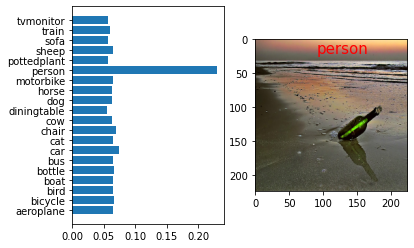

In [32]:
# pred_y0[100]
# Print a few train images with the probabilities (left) and final prediction with image (right)
for i in range(30,40):
  fig, (ax1, ax2) = plt.subplots(1, 2)
  ax1.barh(CAT_LIST,pred_y0[i])
  ax2.imshow(train_X[i])
  ii = 20
  pred_y20 = pred_y0[i] > 0.2

  for item in np.array(CAT_LIST)[pred_y20]:
      ax2.text(90, ii, item, color='r', fontsize=15)
      ii = ii+20
  plt.pause(0.1)

In [33]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

# Consider classes found on the same image as different images and calculate some metrics
print(classification_report(s_true0, s_pred0))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        14
           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00        13
           3       0.00      0.00      0.00         5
           4       0.00      0.00      0.00         5
           5       0.00      0.00      0.00         9
           6       0.00      0.00      0.00        20
           7       0.00      0.00      0.00        11
           8       0.00      0.00      0.00        12
           9       0.00      0.00      0.00         8
          10       0.00      0.00      0.00        13
          11       0.00      0.00      0.00         3
          12       0.00      0.00      0.00        12
          13       0.00      0.00      0.00         7
          14       0.23      1.00      0.38        35
          15       0.00      0.00      0.00         7
          16       0.00      0.00      0.00         5
          17       0.00    

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


<AxesSubplot:>

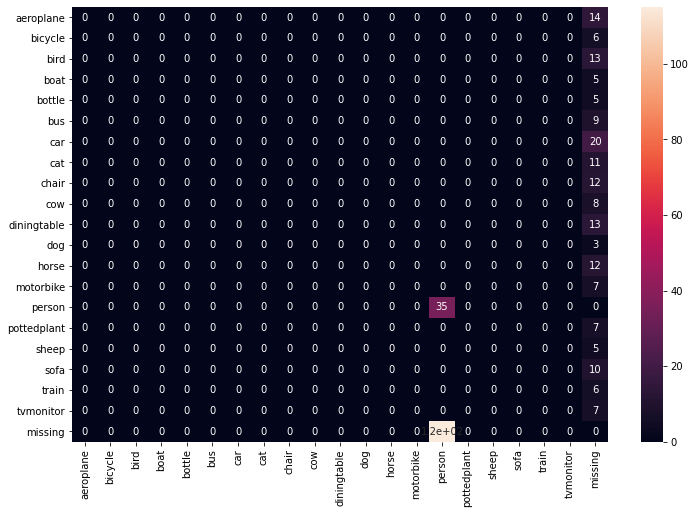

In [34]:
# Plot confusion matrix
CAT_LIST2 = ['aeroplane', 'bicycle', 'bird', 'boat',
        'bottle', 'bus', 'car', 'cat', 'chair',
        'cow', 'diningtable', 'dog', 'horse',
        'motorbike', 'person', 'pottedplant',
        'sheep', 'sofa', 'train',
        'tvmonitor', 'missing']

s_true_arr = np.array(s_true0)
s_pred_arr = np.array(s_pred0)

cm = confusion_matrix(np.argmax(s_true_arr, axis=1), np.argmax(s_pred_arr, axis=1))
plt.figure(figsize = (12, 8))
sns.heatmap(cm, annot=True, xticklabels=CAT_LIST2, yticklabels=CAT_LIST2)

### Discussion:  
We can easily see that our 'from scratch' model fails to give correct outputs. It overfits incredibly right from the start of training (we can see that by examining the very high binary accuracy for each class during training, which is the result of the imbalance of class `'person'`). It is apparent that the network is biased towards `'person'` class and it fails to find the rest of the classes to the images. The very poor performance of this network was expected, since training a deep learning model from scratch requires a lot of time and a lot of data.

### Load the fine tuned Xception model  
we expect this model to perform much better than the first one. We note that we use the $ImageNet$ pre-trained weights for transfer learning, and the model had not seen the `Pascal VOC` dataset before our fine-tuning before.

In [35]:
model = keras.models.load_model('Xception.h5')                                  # load custom cls model
threshold = 0.4

# model = keras.models.load_model('vgg16_ft')                                  # load custom cls model
# threshold = 0.15

test_datagen = ImageDataGenerator(rescale=1./255)                            # make test data generator

In [36]:
train_gen = test_datagen.flow(train_X, batch_size=32, shuffle=False)
test_gen = test_datagen.flow(test_X, batch_size=32, shuffle=False)

pred_y = model.predict(train_gen)
pred_val_y = model.predict(test_datagen.flow(val_X, batch_size=32, shuffle=False))
test_y = model.predict(test_gen)

In [37]:
test_y2 = test_y > threshold
test_df.loc[:, labels] = test_y2.astype(int)

In [38]:
acc = keras.metrics.BinaryAccuracy()
print(f'Accuracy on train set: {round(acc(train_y.astype(float), pred_y.astype(float)).numpy(),4)}')
print(f'Recall on train set: {round(recall_custom(train_y.astype(float), pred_y.astype(float)).numpy(),4)}')
print(f'Precision on train set: {round(precision_custom(train_y.astype(float), pred_y.astype(float)).numpy(),4)}')
print(f'F1 score on train set: {round(f1_custom(train_y.astype(float), pred_y.astype(float)).numpy(),4)}')
print('')
print(f'Accuracy on val set: {round(acc(val_y.astype(float), pred_val_y.astype(float)).numpy(),4)}')
print(f'Recall on val set: {round(recall_custom(val_y.astype(float), pred_val_y.astype(float)).numpy(),4)}')
print(f'Precision on val set: {round(precision_custom(val_y.astype(float), pred_val_y.astype(float)).numpy(),4)}')
print(f'F1 score on val set: {round(f1_custom(val_y.astype(float), pred_val_y.astype(float)).numpy(),4)}')

Accuracy on train set: 0.9890000224113464
Recall on train set: 0.8872
Precision on train set: 0.9561
F1 score on train set: 0.9204

Accuracy on val set: 0.9848999977111816
Recall on val set: 0.6635
Precision on val set: 0.8519
F1 score on val set: 0.7459


In [39]:
s_pred, s_true = multiple2single_one_hot_encoding(train_y, pred_y)
print(np.array(s_true).shape)

(1038, 21)


In [40]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

# Consider classes foud on the same image as different images and calculate some metrics
print(classification_report(s_true, s_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        33
           1       0.82      0.97      0.89        33
           2       1.00      0.98      0.99        42
           3       0.88      0.98      0.92        43
           4       0.71      0.92      0.80        37
           5       0.88      1.00      0.94        29
           6       0.86      0.98      0.91        43
           7       1.00      0.97      0.99        34
           8       0.63      0.93      0.75        57
           9       0.79      1.00      0.88        22
          10       0.69      1.00      0.81        35
          11       0.95      0.95      0.95        40
          12       0.85      0.97      0.91        30
          13       0.87      0.97      0.92        40
          14       0.84      0.95      0.89       172
          15       0.81      0.83      0.82        36
          16       1.00      1.00      1.00        22
          17       0.51    

<AxesSubplot:>

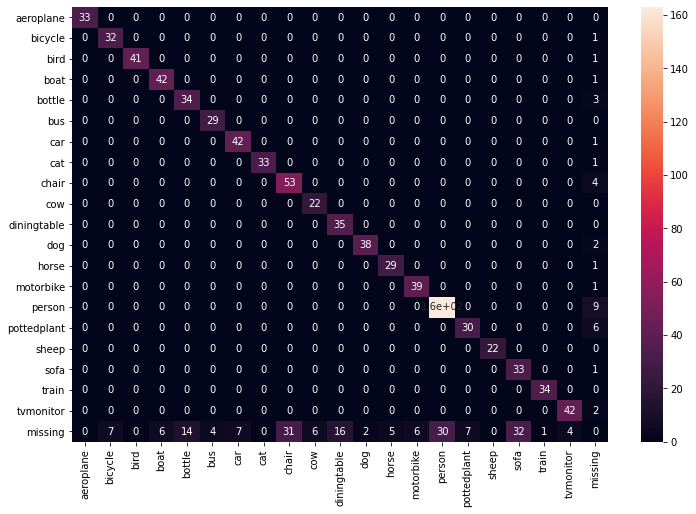

In [41]:
# Plot confusion matrix
s_true_arr = np.array(s_true)
s_pred_arr = np.array(s_pred)

cm = confusion_matrix(np.argmax(s_true_arr, axis=1), np.argmax(s_pred_arr, axis=1))
plt.figure(figsize = (12, 8))
sns.heatmap(cm, annot=True, xticklabels=CAT_LIST2, yticklabels=CAT_LIST2)

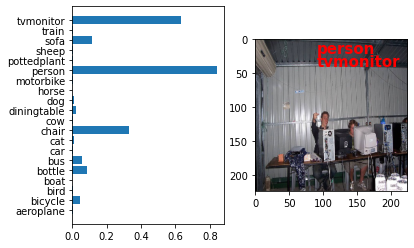

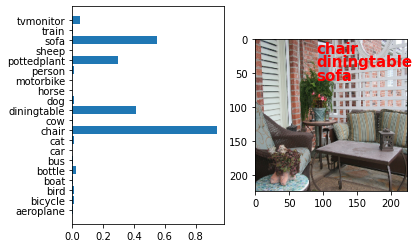

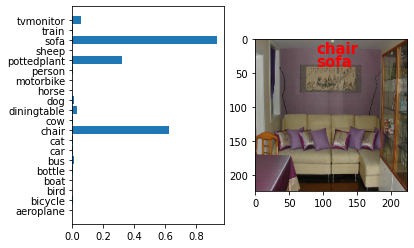

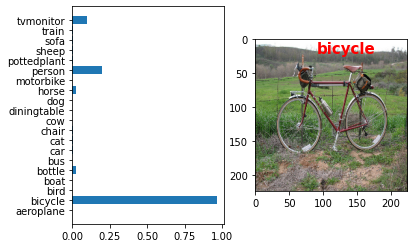

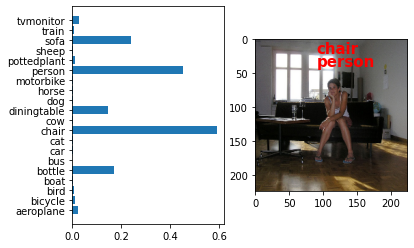

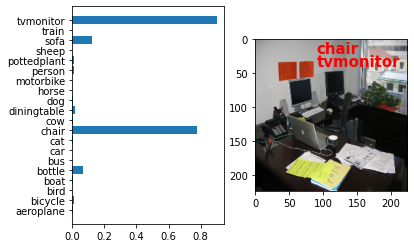

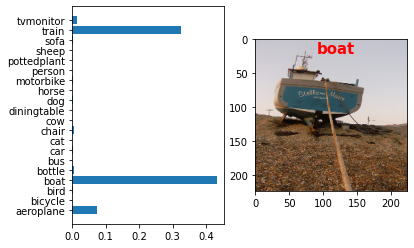

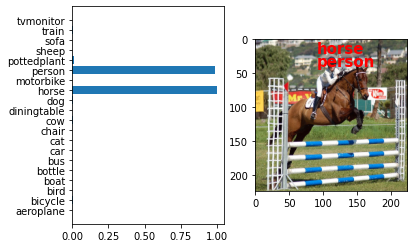

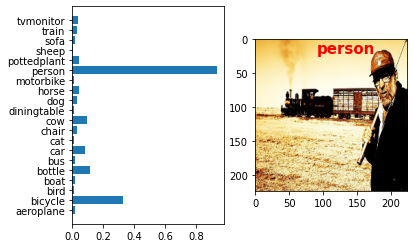

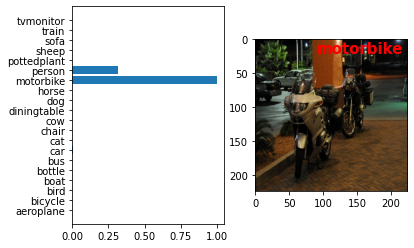

In [42]:
# Print a few test images with the probabilities (left) and final prediction with image (right)
for i in range(10):
  fig, (ax1, ax2) = plt.subplots(1, 2)
  ax1.barh(CAT_LIST,test_y[i])
  ax2.imshow(test_X[i])
  ii=20
  test_y2 = test_y[i] > threshold

  for item in np.array(CAT_LIST)[test_y2]:
      ax2.text(90,ii, item, color='r', fontsize=15, weight='bold')
      ii=ii+20
  plt.pause(0.1)

### Discussion:  
Overall, as expected, the fine tuned model seems to perform significantly better than the model trained from scratch even considering the very little data it was trained with.

Selection of a good threshold plays a really important role in the performance of the network, since there are quite a few predictions with quite big probabilities for wrong classes. A threshold of 0.4 was found optimal for filtering those missclassifications and keeping only the correct classes in the majority of the images.

The Xception model achieved really good accuracy, precision, recall, and f1-score on the training dataset more so than in the validation set, which indicates a degree overfitting. This could have been alleviated by using more data to train (eg. other dataset with same classes) or other forms of regularization.

# 3. Semantic segmentation
In this section, we implement a segmentation CNN that labels every pixel in the image as belonging to one of the 20 classes (including background). 

## Approach
Our approach involves two steps. Firstly, we implemented a segmentation model that was trained from scratch and then we switched to a segmentation model that utilized pretrained networks (eg. $VGG$, $ResNet$ etc.). The aim was to evaluate which network classified the most pixels correctly according to the provided ground truth. In the following segments, we demonstrate how we preprocess the data to make them compatible with the segmentation networks. Then we create dataloaders that feed batches of RGB images and segmentation masks to the networks for training and validation. After each model is trained/loaded we provide some evaluation about the training and then we show some predictions and compare them with the ground truth to validate the performance of each network.
![title](https://www.jeremyjordan.me/content/images/2018/05/Screen-Shot-2018-05-17-at-9.02.15-PM.png)

In [43]:
""" Install required packages for segmentation task """
with io.capture_output() as captured:
    !pip install keras_applications==1.0.8
    !pip install image-classifiers==1.0.0
    !pip install efficientnet==1.0.0
    !pip install albumentations
    !pip install segmentation-models
    !pip3 install numba

## 3.1 Data Preparation and Utility Functions   
### 3.1.1. Dataset and Dataloader classes
The loading of the images and masks for training is achieved using a Dataset and a Dataloader class.

The Dataset class stores the image-mask pairs as member variables along with some additional information, such as the IDs and names of the classes, and data augmentation and preprocessing routines. The dataset class functions as an iterator that each time returns the next image-mask pair in the list.

The Dataloader class on the other hand wraps a Dataset object and each time its accessed, it outputs a batch of image-mask pairs extracted from the dataset. The Dataloader performs shuffling at the end of each epoch to make the model more robust and avoid overfitting/underfitting by varying the batches in each epoch. This is especially useful in cases of datasets that are sorted according to class labels as more diverse batches also favors generalization.

In [44]:
# classes for data loading and preprocessing
from tensorflow.keras.utils import Sequence

class Dataset:
    """Read images, apply augmentations and transformations"""
 
    def __init__(self, images, masks, augmentation=None, preprocessing=None, one_hot_encoding=True):
        self.ids = [id for i in range(len(images))]
        self.images = images
        self.masks = masks
        self.class_values = [cls for cls in range(20)]
        self.class_labels = ['aeroplane', 'bicycle', 'bird', 'boat',
            'bottle', 'bus', 'car', 'cat', 'chair', 'cow',
            'diningtable', 'dog', 'horse', 'motorbike', 'person',
            'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor'
        ]
        self.augmentation = augmentation
        self.preprocessing = preprocessing
        self.one_hot_encoding = one_hot_encoding
    
    def __getitem__(self, i):
        image = self.images[i]
        mask = self.masks[i]
        
        if self.one_hot_encoding:
            # extract certain classes from mask (e.g. cars)
            masks_ = [(mask == v) for v in self.class_values]
            mask = np.stack(masks_, axis=-1).astype('float')

            # add background if mask is not binary
            if mask.shape[-1] != 1:
                background = 1 - mask.sum(axis=-1, keepdims=True)
                mask = np.concatenate((mask, background), axis=-1)

        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            image,mask = self.preprocessing(img=image, target=mask)
        return image, mask

    def return_item(self,i):
        return self.__getitem__(i)

    def __len__(self):
        return len(self.ids)

class Dataloader(Sequence):
    """Load data from dataset and form batches
    Args:
        dataset: instance of Dataset class for image loading and preprocessing.
        batch_size: Integet number of images in batch.
        shuffle: Boolean, if `True` shuffle image indexes each epoch.
    """
    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))
        self.on_epoch_end()
        

    def __getitem__(self, i):
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        # transpose list of lists
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
    
        return batch[0], batch[1]
    
    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

### 3.1.2 Utility functions for visualization

This section contains utility functions for visualizing the dataset and model predictions as well as training metrics.

In [45]:
from matplotlib import pyplot as plt

def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    fig = plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()

def visualize_img_mask_pred_hist(image, mask, prediction, labels):
    """Plot a quadrupplet image, gt-mask, prediction, and class histogram"""
    fig, ax = plt.subplots(1, 4, figsize=(22, 4))
    ax[0].imshow(image); ax[0].set_title('Image')
    ax[1].imshow(prediction); ax[1].set_title('Prediction')
    try:
        if np.any(mask.ravel()):
            if len(mask.shape) == 3 and mask.shape[-1] > 3:
                mask = np.argmax(mask.squeeze(), axis=2)
            ax[3].hist(mask[np.nonzero(mask)].ravel(), bins=range(len(labels)+1), density=True, alpha=0.3, label='ground truth', orientation="horizontal")
            ax[2].imshow(mask); ax[2].set_title('Ground Truth')
        ax[3].hist(prediction[np.nonzero(prediction)].ravel(), bins=range(len(labels)+1), density=True, alpha=0.3, label='prediction', orientation="horizontal")
        ax[3].set_title('Pixel Class Histogram of Prediction')
#         ax[3].set_ylabel('class') 
        ax[3].set_xlabel('density')
        ax[3].set_yticks(ticks=np.arange(len(labels))+0.5)
        ax[3].set_yticklabels(labels=labels, rotation='horizontal')
        ax[3].set_ylim(top=1, bottom=21)
        ax[3].legend()
    except RuntimeWarning as err:
        print('Plotting of histogram failed with: ', err)
    return fig

def visualize_examples(model, dataset, n=1, seed=12345):
    """Visualizes multiple examples"""
    np.random.seed(seed)
    indices = np.random.choice(len(dataset), n, replace=False)
#     print('Sample indices: ', indices)
    for idx in indices:
        img, mask = dataset[idx]
        pred = np.round(model.predict(np.expand_dims(img, 0)))
        pred = np.argmax(pred.squeeze(), axis=2)
        visualize_img_mask_pred_hist(
            image=img.squeeze(),
            prediction=pred,
            mask=mask,
            labels=['bg'] + dataset.class_labels,
        )

def denormalize(x):
    """Scale image to range 0..1 for correct plot"""
    x_max = np.percentile(x, 98)
    x_min = np.percentile(x, 2)
    x = (x - x_min) / (x_max - x_min)
    x = x.clip(0, 1)
    return x

def plot_segmentation_metrics(history):
    """Plots the metrics in the history of training"""
    metrics = history
    num_metrics = len(metrics.keys())
    fig, ax = plt.subplots(1,num_metrics//2, figsize=(4 * num_metrics, 5))
    for idx, key in enumerate(metrics):
        if key == 'lr':
            continue
        if 'val_' in key:
            idx = idx - num_metrics // 2
        if 'loss' in key:
            ax[idx].set_yscale('log')
        if 'io_u' in key:
            ax[idx].set_ylim([0, 1])
        ax[idx].plot(metrics[key].values, label=key)
        ax[idx].set_xlabel('epoch')
        ax[idx].legend()
        ax[idx].grid(True)
      
    return fig

### 3.1.3 Data Preprocessing

Preprocessing of the data aims to prepare the data by converting them to a format that is compatible with the segmentation networks. Preprocessing involves the following:
- Resizing of the image and mask to $(256,256)$ for feeding to the networks
- (optional) Normalization of the input image to the range $[0,1]$
- (optional) Rounding of the mask values to 0-1 to remove artifacts of the resizing operation. Used when the mask is in **one-hot-encoding** format.

In [46]:
def preprocess_dataset(img, target, norm_input=True, round_output=True):
    # preprocess rgb image
    x_r = img
    x_r =  cv2.resize(img, (256,256), interpolation = cv2.INTER_CUBIC)
    x_r = x_r/255 if norm_input else x_r
    # preprocess segmentation mask
    y_r = target
    y_r[y_r==255] = 0
    
    if round_output:
        y_r = cv2.resize(y_r, (256,256))
        y_r[y_r>0.5] = 1
        y_r[y_r<0.5] = 0
    else:
        y_r = np.expand_dims(cv2.resize(y_r, (256,256)), 2)
    return x_r, y_r

### 3.1.4 Data Augmentation

As mentioned already in the classification task, the provided dataset is very small and **highly imbalanced**, even more so considering that in the case of segmentation, the background class is dominant. As a result, we decided to use data augmentation, which aims to create more data samples from existing samples and apply different image processing techniques to create more variety in the data, which prevents overfitting and enables the network to generalize better on unseen data.

Data augmentation is performed using the `albumentations` library, which is a lot more flexible and provides more variety with regard to image processing techniques than the default data augmentation modules of Keras.  

Some examples of data augmentation that is applied on the data are:    horizontal flip with 50% probability, shifting the image horizontally and/or vertically, adding gaussian noise, changing the brightness etc. This ensures that the network does not see an object in only one pose for example and thus does not overfit on it, but rather learns how to classify it in different positions orientations, brightness settings etc.

In [47]:
import albumentations as A

# define heavy augmentations
def get_training_augmentation():
    train_transform = [
        A.HorizontalFlip(p=0.5),
        A.ShiftScaleRotate(scale_limit=0.2, rotate_limit=30, shift_limit=0.1, p=0.7, border_mode=0),
        A.PadIfNeeded(min_height=256, min_width=256, always_apply=True, border_mode=0),
        # A.RandomCrop(height=200, width=200, p=0.2),
        A.IAAAdditiveGaussianNoise(p=0.2),
        A.IAAPerspective(p=0.5),
        A.OneOf([A.CLAHE(p=1), A.RandomBrightness(p=1), A.RandomGamma(p=1)], p=0.9),
        A.OneOf([A.IAASharpen(p=1), A.Blur(blur_limit=3, p=1), A.MotionBlur(blur_limit=3, p=1)],p=0.9),
        A.OneOf([A.RandomContrast(p=1), A.HueSaturationValue(p=1)], p=0.9),
        # A.Lambda(mask=round_clip_0_1)
    ]
    return A.Compose(train_transform)

## 3.1 Segmentation model from scratch

We start with [U-Net](https://arxiv.org/abs/1505.04597) by Ronneberger et al. from 2015, one of the most well-known segmentation models that revolutionized the field. The $U-Net$ architecutre builds upon **Fully Convolutional Networks**, meaning that it contains only convolutional layers and not fully connected layers, which enables the network to work with any arbitrarily squared shaped image. Another important advantage of $U-Net$ is that it requires less training data than its predecessor. The name $U-Net$ comes from the the shape of its architecture which contains an encoder - contracting layer and a decoder - expansive layer which are connected using skip-connections resulting in a U-shape.

When creating a segmentation algorithm/network there is a trade-off between localization accuracy and the use of context. Using smaller convolutional layers results in higher localization accuracy which denotes where a pixel of a specific class is located in the image. Using larger convolutional layers on the other hand results in acquiring more contextual information. For example, the neighbouring area of a pixel is more important in determining the pixel's class than the color/intensity of the pixel itself. $U-Net$ tackles this issues and provides an improved localization accuracy through the use of skip-connections. Skip-connections connect encoder layers with the corresponding symmetric decoder layers resulting in increased localization accuracy of high resolution features. These connections basically propagate context information to higher resolution channels.

Training a $U-Net$ segmentation model from scratch was based on one of the tutorials of Keras: [Image segmentation with a U-Net-like architecture](https://keras.io/examples/vision/oxford_pets_image_segmentation)

### 3.2.1 U-Net Model

In [48]:
from tensorflow.keras import layers
import tensorflow as tf
from tensorflow import keras


def create_unet(img_size=(256, 256), num_classes=21):
    inputs = keras.Input(shape=img_size + (3,))

    ### [First half of the network: downsampling inputs] ###

    # Entry block
    x = layers.Conv2D(32, 3, strides=2, padding="same")(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    previous_block_activation = x  # Set aside residual

    # Blocks 1, 2, 3 are identical apart from the feature depth.
    for filters in [64, 128, 256]:
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        # Project residual
        residual = layers.Conv2D(filters, 1, strides=2, padding="same")(
            previous_block_activation
        )
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    ### [Second half of the network: upsampling inputs] ###
    for filters in [256, 128, 64, 32]:
        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.UpSampling2D(2)(x)

        # Project residual
        residual = layers.UpSampling2D(2)(previous_block_activation)
        residual = layers.Conv2D(filters, 1, padding="same")(residual)
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    # Add a per-pixel classification layer
    outputs = layers.Conv2D(num_classes, 3, activation="softmax",
                            padding="same")(x)

    # Define the model
    model = keras.Model(inputs, outputs)
    return model

### 3.2.2 Evaluation Metrics  
Evaluating the performance of semantic segmentation algorithms requires a more suitable metric than the usual Accuracy metric. This becomes apparent if one considers that matching a predicted segmentation mask with its ground truth would have a really high accuracy in cases where the background covers the majority of the image pixels.

One of the most widely used evaluation metrics for segmentation tasks is the [Intersection-over-Union or IoU](https://towardsdatascience.com/intersection-over-union-iou-calculation-for-evaluating-an-image-segmentation-model-8b22e2e84686). The $IoU$ in object detection tasks is basically the percentage of the intersection of the predicted bounding box of an object with the corresponding ground truth bounding box. This is easily transferred to segmentation, where instead of bounding boxes we measure the intersection of masks for each class. Since it's a percentage it's value is in the range $[0, 1]$, where 1 denotes perfect intersection of prediction and ground truth.

In [49]:
# modification of MeanIoU that converts a 2D mask to categorical format (HxWx1) -> (HxWxC)
class MeanIoUMod(keras.metrics.MeanIoU):
    def __init__(self, y_true=None,  y_pred=None, num_classes=None, name=None, dtype=None):
        super(MeanIoUMod, self).__init__(num_classes=num_classes, name=name, dtype=dtype)

    def update_state(self, y_true, y_pred, sample_weight=None):
        y_pred = tf.math.argmax(y_pred, axis=-1)
        return super().update_state(y_true, y_pred, sample_weight)

### 3.2.3 Creation of Training and Validation Datasets

In this section we split the training data into training and validation sets with $0.8$ and $0.2$ ratios, respectively. To accomplish this task we utilize the *train\_test\_split* function of _sklearn_. A potential improvement would be to use the stratified option, which would split the data in such a way that the proportion of each class in each one of the training and validation sets is equal. For example, if $30%$ of the training set contains images with people corresponding to the person class then the validation set would also contain $30%$ person samples. This would alleviate the case where one class might be present in the validation set but not in the training set or in very small proportion compared to the other classes.

After the training data is split into training and validation sets, we create one dataset object for each one. It is important to note that in this case we don't use the one-hot-encoding / categorical format of the mask $(HxWxC)$, but instead we use the single channel format $(HxWx1)$ in contrast to the pretrained model in the following section. This channel contains integer values ranging from 0 to 21, where 0 corresponds to the background and the rest of the values correspond to our 20 classes. In contrast, the pretrained segmentation model that is presented in secion 3.3, requires datasets with the one-hot-encoding format, where each pixel of the 21 masks is between 0 and 1.

Some example images are visualized as a **sanity check** to ensure that the data we are working with are properly formatted.

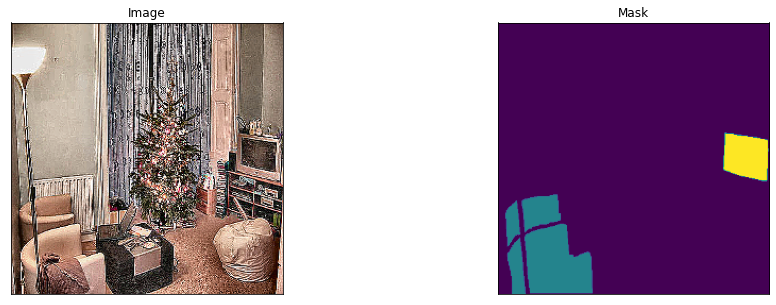

In [50]:
from functools import partial
from sklearn.model_selection import train_test_split

# split data into training and validation sets
input_imgs = train_df['img'].values
target_imgs = train_df['seg'].values
train_X, val_X, train_y, val_y = train_test_split(input_imgs, target_imgs, test_size=0.2,random_state=1) 

# Create training and validation sets
prec_fun = partial(preprocess_dataset, norm_input=False, round_output=False) # disasble one-hot encoding
ds_train = Dataset(train_df['img'],train_df['seg'],
             preprocessing=prec_fun,
             augmentation=get_training_augmentation(),
             one_hot_encoding=False)
ds_val = Dataset(val_X, val_y, 
                 preprocessing=prec_fun,
                 one_hot_encoding=False)

# visualize an img-segmentation pair as a sanity check
x,y = ds_train[8]
visualize(image=x, mask=y)

### 3.2.4 U-Net Training
$U-Net$ is trained from scratch on VOC-2009. We use a learning rate of `1e-3`, a batch size of 32 image-mask pairs, and an image size of $256x256$ and we train the network for 200 epochs. As mentioned already, the training dataset is shuffled to provide more varied batches to the network to prevent overfitting and speed up the learning process.

Three **callback** functions are used during training. One is aimed to save checkpoints of the model at the end of an epoch if and only if there is an improvement on the loss. The second one monitors the **validation loss** and if there is no improvement in over a certain number of epochs, then it lowers the learning rate by a factor of $0.2$. This ensures that if the network oscillates around a local minimum of the loss, then with a lower learning rate it might be able to more accurately approach it. The third and final callback function monitors the validation loss as well, but this time if it doesn't increase for over a certain number of epochs, the training is terminated, since the network has either stagnated or overfitted on the training set. 

The **Adam** optimizer is used to train the network, which promises a faster convergence than a regular SGD. The loss that the optimizer aims to minimize is called Sparse Categorical Cross Entropy. The **Categorical Cross Entropy** evaluates the predictions of each pixel and then averages the result ([ref](https://www.jeremyjordan.me/semantic-segmentation/)). One disadvantage of this loss function is that it considers all classes with the same importance, which means that if we have an imbalanced dataset one class can easily dominate the others. Besides the loss function, we also use the average $IoU$ over an entire epoch to evaluate how training is progressing.

In [51]:
""" Train or load model """
import os
from tensorflow.keras.optimizers import Adam
from numba import cuda

LR = 1e-3
EPOCHS = 500
BATCH_SIZE = 16
CLASSES = 21
IMG_SIZE = (256, 256)

# create dataloaders
train_dataloader = Dataloader(ds_train, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloader(ds_val, batch_size=BATCH_SIZE, shuffle=False)

# create callbacks
callbacks = [
    keras.callbacks.ModelCheckpoint('/kaggle/output/unet.h5', save_weights_only=True, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau(factor=0.2, monitor='val_loss', min_lr=1e-5, verbose=1, patience=20),
    keras.callbacks.EarlyStopping(monitor='val_loss', patience=30, verbose=1, restore_best_weights=True),
]

# create and compile model
model = create_unet(img_size=IMG_SIZE, num_classes=CLASSES)
model.compile(
    keras.optimizers.Adam(lr=LR),
    loss="sparse_categorical_crossentropy",
    metrics=[MeanIoUMod(num_classes=CLASSES)]
)

# empty gpu memory
# cuda.get_current_device().close()
tf.keras.backend.clear_session()

# train or load model if weights are available
if os.path.exists('unet.h5'):
    print('Found trained model')
    model.load_weights('unet.h5')
else:
    print('Training from scratch')
    history = model.fit(
        train_dataloader,
        steps_per_epoch=len(train_dataloader),
        epochs=EPOCHS,
        callbacks=callbacks,
        validation_data=valid_dataloader,
    )
    
    # write history to file
    hist_df = pd.DataFrame(history.history)
    fn = '/kaggle/output/unet_history.csv'
    with open(fn, mode='w') as f:
        hist_df.to_csv(f)

Found trained model


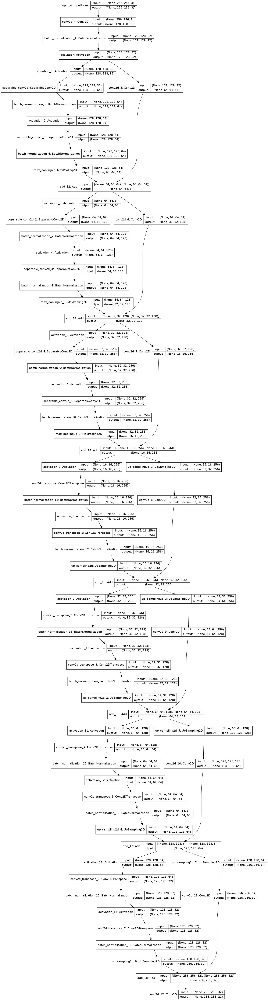

In [52]:
plot_model(model, show_shapes=True, show_layer_names=True)

### 3.2.5 U-Net Training Evaluation  
Initially, we didn't use any data augmentation on the data, which resulted in a very early divergence between the training and validation losses, which denotes overfitting. Utilizing data augmentation alleviated this issue as we can see in the following plot. This plot contains two graphs demostrating the loss and $IoU$ of training and validation. As desired, we see that the training loss and validation loss are decreasing steadily with some minor oscillations, while the corresponding $IoUs$ are increasing at a similar rate. The validation loss and $IoU$ tend to **plateau** at around $0.2$ and $76%$, respectively, which is quite good, but there is room for improvement.

Loading training history from older run


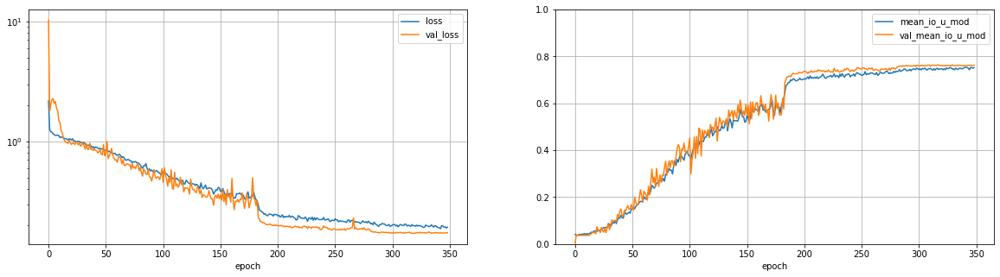

Final loss: 0.1928334087133408, val_loss: 0.17279157042503354
Final iou: 0.7520022392272949, val_iou: 0.7621212005615234


In [53]:
if os.path.exists('/kaggle/output/unet_history.csv'):
    print('Loading training history from current run')
    hist_df = pd.read_csv('/kaggle/output/unet_history.csv', index_col=0)
    plot_segmentation_metrics(hist_df); plt.show()
elif os.path.exists('unet_history.csv'):
    print('Loading training history from older run')
    hist_df = pd.read_csv('unet_history.csv', index_col=0)
    plot_segmentation_metrics(hist_df); plt.show()
    print(f'Final loss: {hist_df["loss"].values[-1]}, val_loss: {hist_df["val_loss"].values[-1]}')
    print(f'Final iou: {hist_df["mean_io_u_mod"].values[-1]}, val_iou: {hist_df["val_mean_io_u_mod"].values[-1]}')
else:
    print('No training history found.')

### 3.2.6 Evaluation of predictions
Firstly, we evaluate our trained $U-Net$ model on the training set, where we expect better results in general. As we can obeserve from the following examples, the model manages to correctly classify the pixels of interest in most cases, although, we do see a lot of misclassified pixels. Similar to the classification task we observe a tendency of the network to almost always classify some pixels as the class **person**, which is dominant in our imbalanced dataset. Furthermore, we observe that the network has quite some difficulty classifying pixels on the borders between two different classes as well as very narrow/thin features such as legs of a horse or dog or hollow patches and generally tends to do better with concetrated blobs. This can be attributed to the inability of our network to recognize high resolution features. This could potentially be alleviated by increasing the layers of the network with a corresponding increase of the number of features.

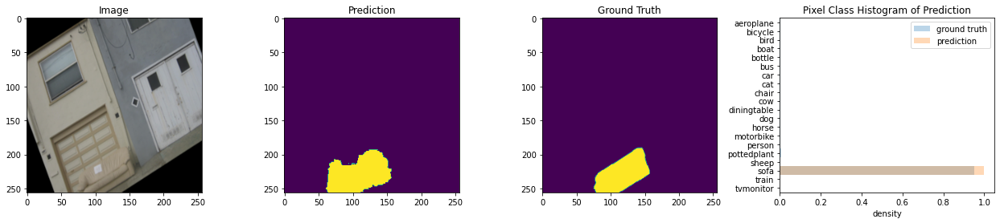

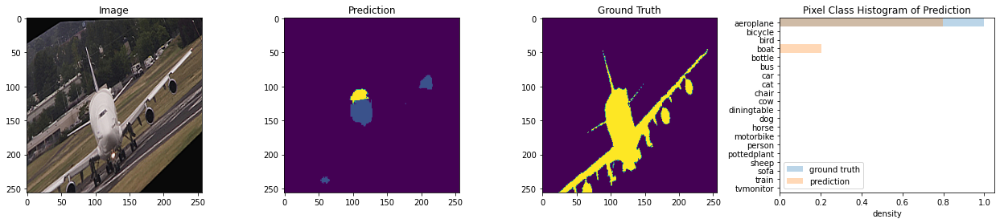

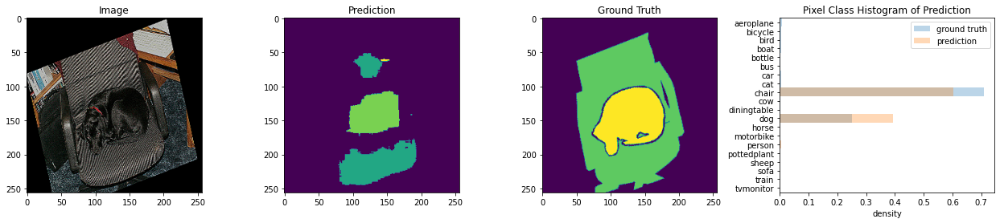

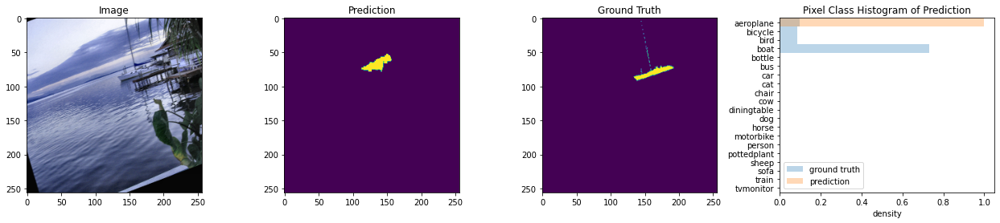

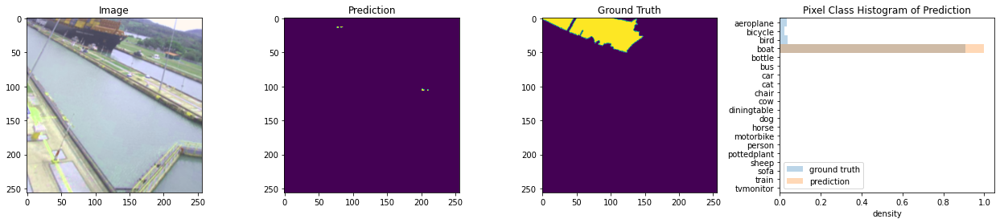

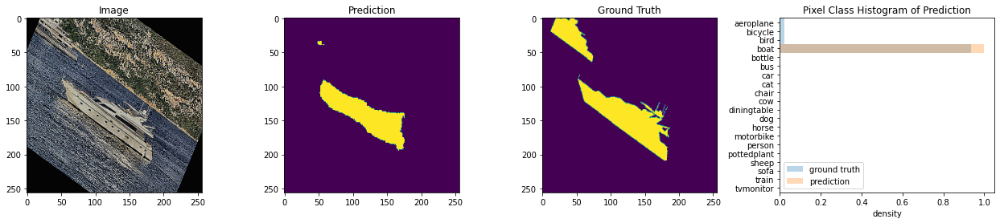

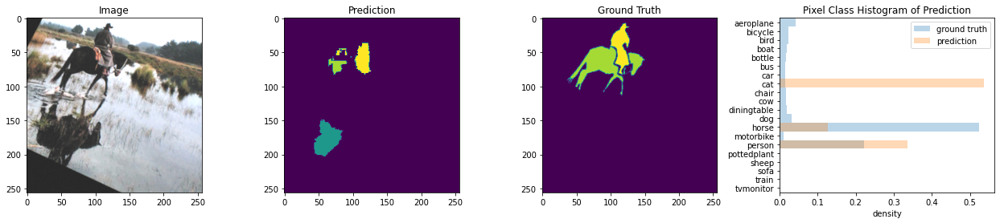

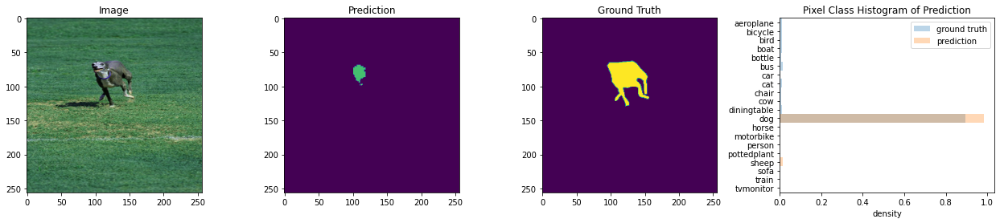

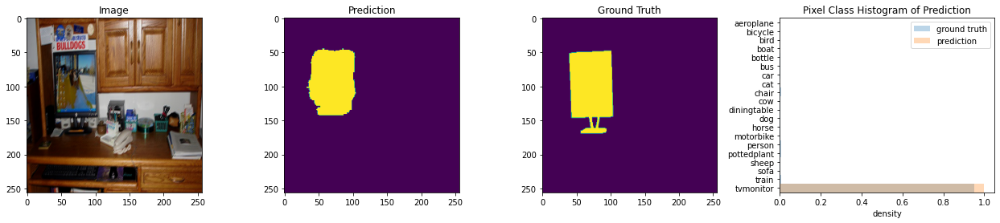

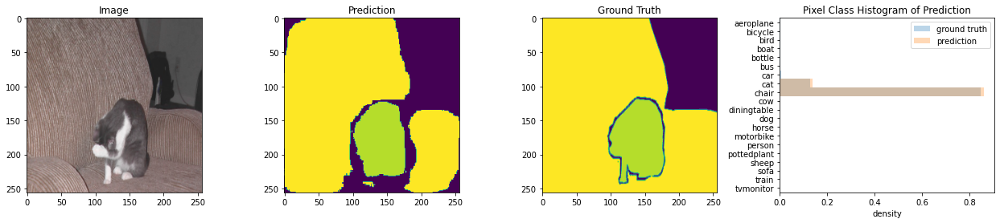

In [54]:
"""Visualize training set prediction examples"""
visualize_examples(model, ds_train, 10)

Now we plot some predictions for the validation set. We observe again approximately the same results as in the training set. The network almost always succeeds in correctly classifying the majority of pixels but there are some misclassifications or no classification at all in case of high resolution features.

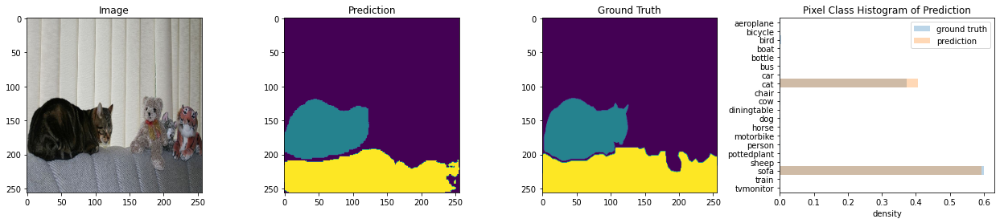

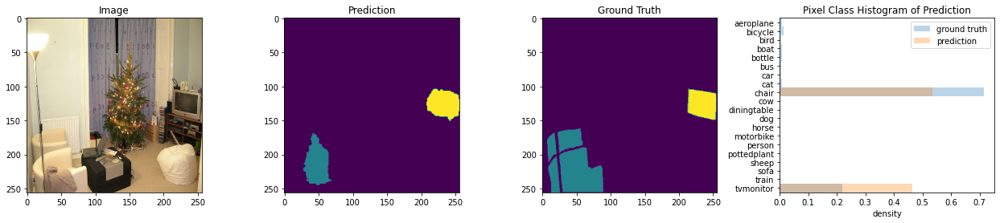

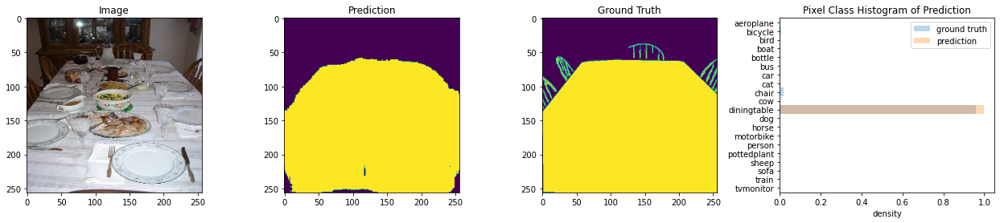

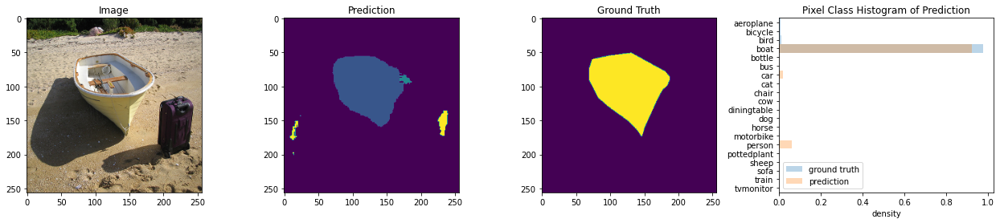

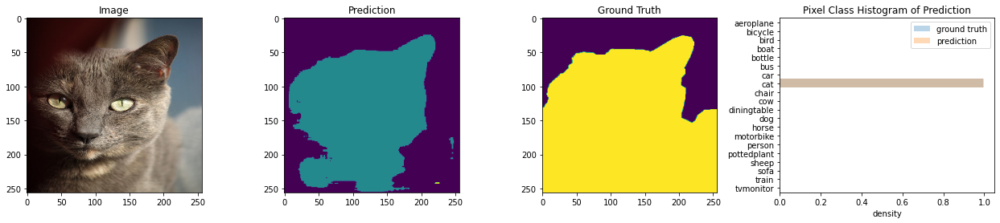

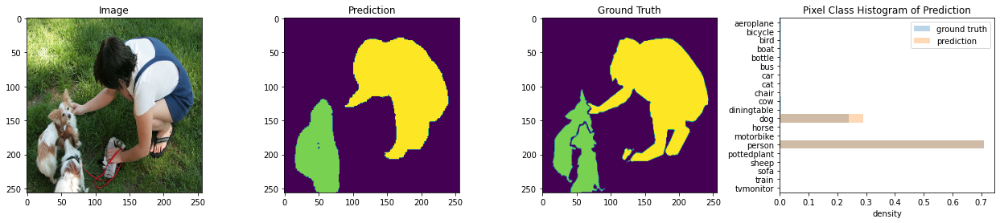

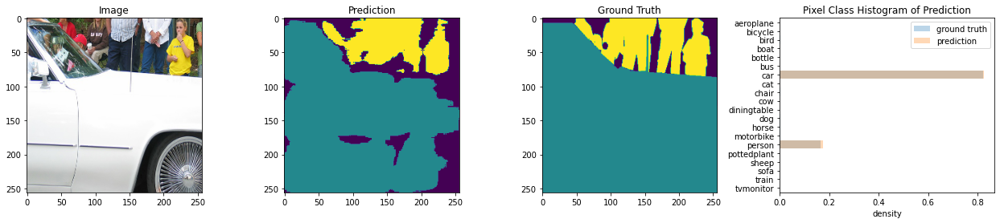

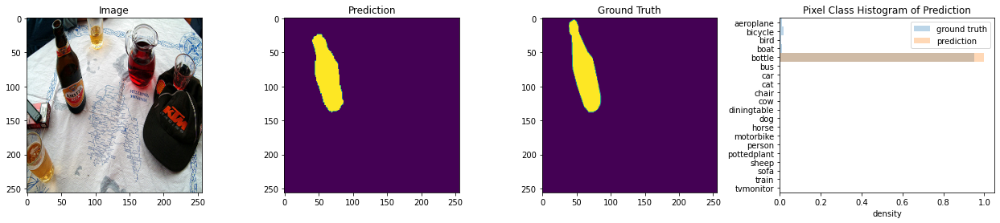

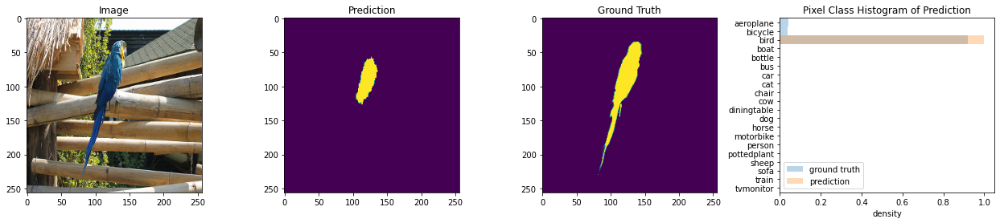

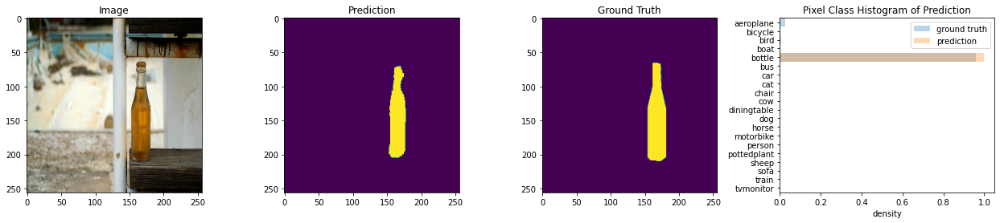

In [55]:
"""Visualize validation set prediction examples"""
visualize_examples(model, ds_val, 10)

Finally we plot some predictions using images from the test set, where, through visual inspection of the results, we observe that the network performs way worse than in the case of the training or validation sets. This time the network fails to correctly classify most pixels even for the dominant class _person_. This indicates a possible overfitting on the training data.

/opt/conda/lib/python3.7/site-packages/numpy/lib/histograms.py:905: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


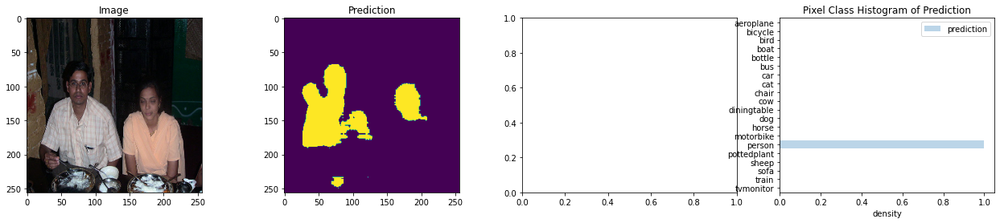

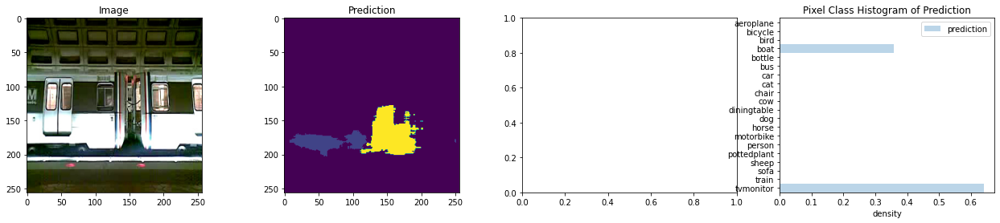

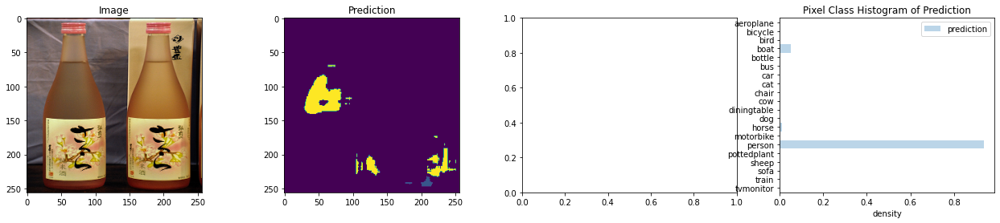

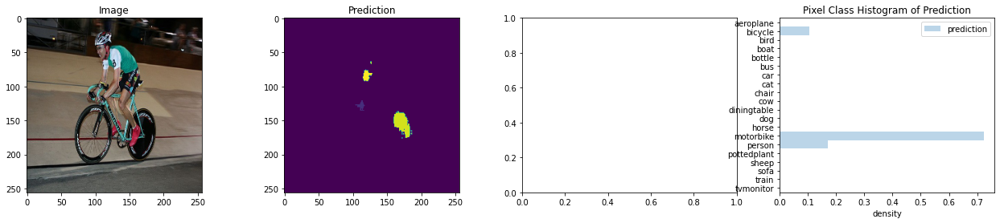

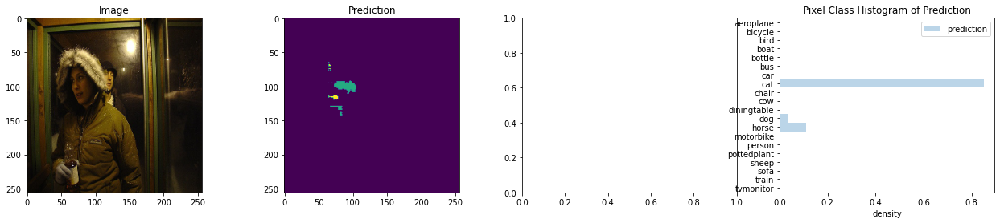

...

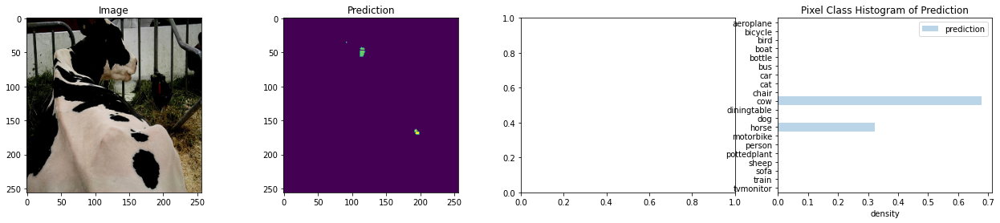

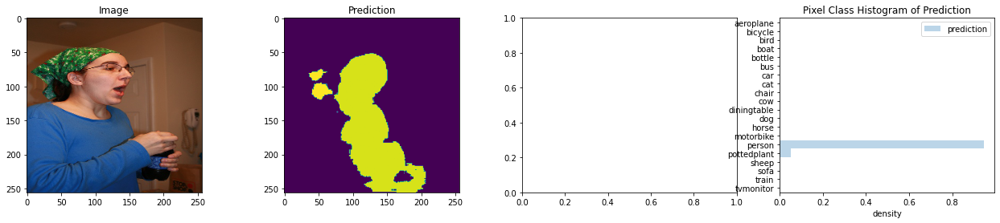

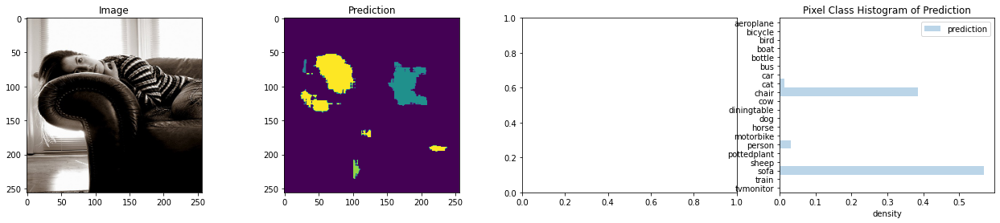

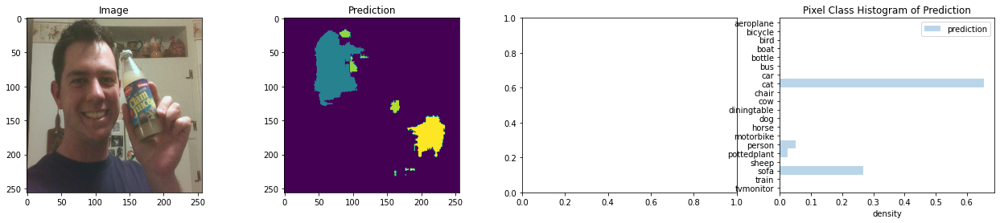

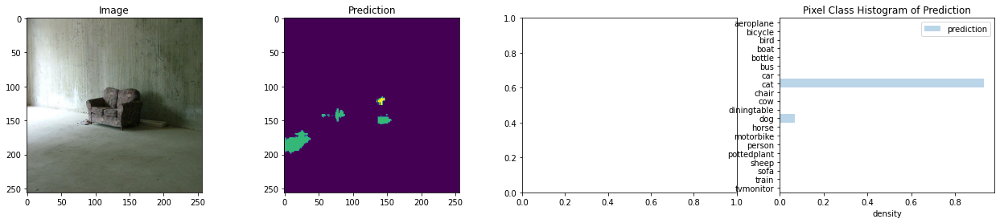

In [56]:
"""Load test set"""
test_X, test_y = test_df['img'], test_df['seg']
ds_test = Dataset(test_X, np.zeros((len(test_X),256,256), dtype=int), preprocessing=prec_fun, one_hot_encoding=False)

"""Visualize test set prediction examples"""
visualize_examples(model, ds_test, 20)

###  3.2.7 Discussion

In this section we trained a U-Net semantic segmentation network on `VOC-2009`. The network managed to achieve really good $IoU$ scores for training and validation sets, but didn not fare as well on the test set. Based on this experiment, one of the most important conclusions was that data augmentation is essential in training a semantic segmentation network to prevent overfitting especially when we have too little data or an imbalanced dataset to train with. In the next section we look into pretrained segmentation networks and finetuning as a means to improve our IoU score on `VOC-2009`.

## 3.3 Segmentation using a Pretrained Model

In this part, we will approach the problem from a different perspective. The goal is to utilize a pretrained model to achieve better results than the 'from scratch' model.
More concretely, we will experiment with models which have already been trained on [Imagenet dataset](https://www.image-net.org/). This means that the model can already provide us good feature representations and therefore we will try to enhance the perfomance by training/fine-tuning it on the given dataset.


Following the same approach we will use augmentations provided by the `albumentation` lib.
On top of that we will use [segmentation models library](https://github.com/qubvel/segmentation_models) which is based on keras and tensorflow, and provides `APIs` which makes the creation of several models easy. It also provides ready-to-use metrics such as $IoU$. 

A classic approach for such networks is the architecture of encoder-decoder. In this architecture the goal is to firstly downsample the input into higly discriminative features for the classification task and then upsample these features to result into semantic segmentation.

![](https://www.jeremyjordan.me/content/images/2018/05/Screen-Shot-2018-05-16-at-10.33.29-PM.png)


In our case, we will the part of the encoder will be pretrained and will only be finetuned during our training, whereas the decoder will be trained in order to achieve semantic segmentation.
#### Model structure
We experimented with the most promising model structures U-NET and FPN.

$U-NET$ is a convolutional network that aims to perform precise segmentation of images in the biomedical field which outperforms other approaches. The authors of the [paper of U-net](https://doi.org/10.1007/978-3-319-24574-4_28) network suggest also that the training does not require many images and is not costly in terms of time. 
![](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/u-net-architecture.png)


Feature Pyramid Network ($FPN$) was also used [[ref](https://paperswithcode.com/method/fpn)]. The construction of the pyramid involves a bottom-up pathway and a top-down pathway. The bottom-up pathway is the feedforward computation of the backbone $ConvNet$, which computes a feature hierarchy consisting of feature maps at several scales. For the feature pyramid, one pyramid level is defined for each stage. The output of the last layer of each stage is used as a reference set of feature maps. For $ResNets$ we use the feature activations output by each stage’s last residual block. 
![](https://paperswithcode.com/media/methods/new_teaser_TMZlD2J.jpg)


#### Backbone model - Encoder

Even though we tried several pretrained backbone models, the best results were achieved by $Inceptionv3$ (deep convolutional neural network). [Inceptionv3](https://blog.paperspace.com/popular-deep-learning-architectures-resnet-inceptionv3-squeezenet/) is not a common CNN as it incorporates the notion of assymetric convolutions which seems to deliver good results.  At the same time this architecture consists of less layers that i.e. $ResNet101$ but still delivers superior results. Inceptionv3 is used with pretrained weights on Imagenet Dataset 
We also experimented with $ResNet$ and $VGG$ Architectures but Inceptionv3 outperfomed both. 
![](https://d3i71xaburhd42.cloudfront.net/9a786d1ecf77dfba3459a83cd3fa0f1781bbcba4/3-Figure2-1.png)
Source : Canziani, A., Paszke, A., & Culurciello, E. (2016). An Analysis of Deep Neural Network Models for Practical Applications. ArXiv, abs/1605.07678.


#### Loss functions

Dice loss measures the overlapping area divided by the total number of pixels in both images.
$$Dice Loss =\dfrac{2|X∩Y|}{|X|+|Y|}$$

Focal loss 
Focal loss is an extension of cross-entropy loss, which focuses on rare classes as it "penalizes" more the hard-to-classify instances. It is also adequate for imbalanced dataset like ours.
$$FL(p)=−(α(1−p)^γplog(p)+(1−α)p^γ(1−p)log(1−p))$$

The loss function used is an sum of both loss functions mentioned above.


#### Evaluation metric
The Jaccard index or Intersection over Union metric is used as it can effectively quantify the performance of the model in terms of the segmenation quality. The threshold used for IoU is 0.5

![](https://i2.wp.com/neptune.ai/wp-content/uploads/IoU-balanced-Loss.png?ssl=1)

Additionaly we use the F-score, as it is correlated with Jaccard index.

**Sources:**  
https://ayodeleodubela.medium.com/what-does-focal-loss-mean-for-training-neural-networks-770636f76379  
https://github.com/qubvel/segmentation_models  
https://www.jeremyjordan.me/semantic-segmentation/  
https://medium.com/nanonets/how-to-do-image-segmentation-using-deep-learning-c673cc5862ef  
https://towardsdatascience.com/metrics-to-evaluate-your-semantic-segmentation-model-6bcb99639aa2

(256, 256, 21)


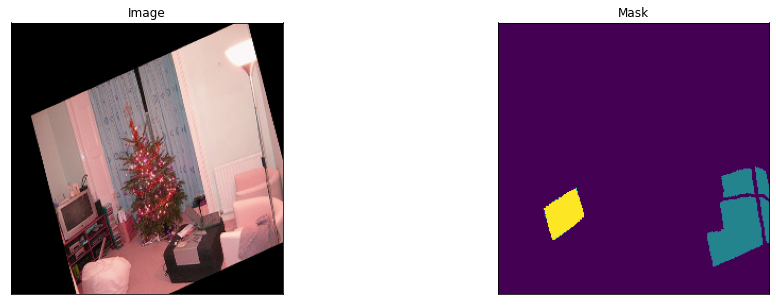

In [57]:
# Get Dataset
ds = Dataset(train_df['img'],train_df['seg'],preprocessing=preprocess_dataset,augmentation=get_training_augmentation())
x,y = ds[8]

print(y.shape)

# Visualize some images
visualize(
    image = x,
    mask = np.argmax(y,axis=2),
)

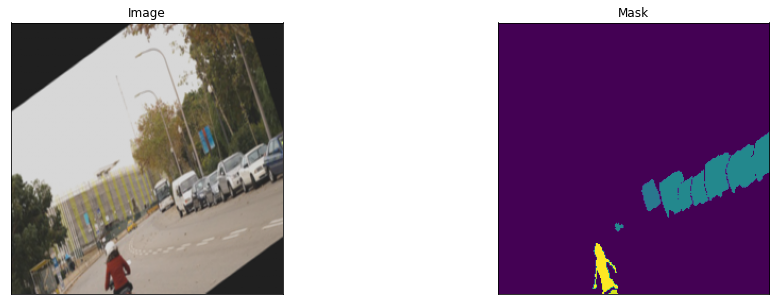

In [58]:
# Build DataLoader
train_dataloader = Dataloader(ds, batch_size=8, shuffle=True)
len(train_dataloader)
batch = train_dataloader[2]

# Visualize some augmentations
visualize(
    image = batch[0][0].squeeze(),
    mask = np.argmax(batch[1][0].squeeze(),axis=2),
)

A major problem in our case is that have converted the segmentation data in such way for training that we ended up with 21 classes. Class 0, which is the background, is dominant in the class distribution as seen below and the same should apply in the test data. For that reason we intend to adjust the weights of the $Dice loss$, to decrease the influence of **BACKGROUND** during training.  

In [59]:
from sklearn.model_selection import train_test_split      
from keras.utils import to_categorical

def reshape_dataset(imgs, targets):
    """ Change shape of dataset"""
    imgs_reshaped = []
    targets_reshaped = []
    for x,y in zip(imgs,targets):
        x_r = x
        x_r = cv2.resize(x, (256,256), interpolation = cv2.INTER_CUBIC)
        # x_r =np.expand_dims(x_r, -1)
        imgs_reshaped.append(x_r)

        y_r = y
        y_r[y_r==255]=0
        y_r = to_categorical(y_r,21)
        y_r = cv2.resize(y_r, (256,256))#, interpolation = cv2.INTER_CUBIC)
        y_r = np.round(y_r)
        targets_reshaped.append(y_r)
        
    return np.array(imgs_reshaped),np.array(targets_reshaped)

input_imgs = train_df['img'].values
target_imgs = train_df['seg'].values

# Split the dataset to train and test sets
train_X, val_X, train_y, val_y = train_test_split(input_imgs, target_imgs, test_size=0.102,random_state=1) 
x_train,y_train = reshape_dataset(train_X,train_y)
np.sum(y_train)
w=[]

# Generate some class weights for the dataset imbalance problem
for i in range(0,21):
    w.append(np.count_nonzero(y_train[...,i]==1))
class_weights = 1/(w/np.sum(y_train)) 
class_weights = (class_weights-np.min(class_weights))/(np.max(class_weights)-np.min(class_weights))
class_weights[0]=0.00001

ds_train = Dataset(train_X,train_y,preprocessing=preprocess_dataset, augmentation=get_training_augmentation())
ds_val = Dataset(val_X,val_y,preprocessing=preprocess_dataset )

Text(0.5, 1.0, 'Class weights')

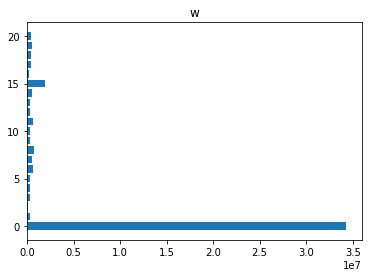

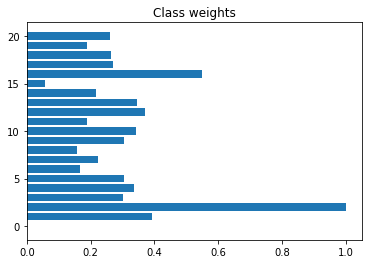

In [60]:
plt.figure()
plt.barh(range(21), w)
plt.title('w')

plt.figure()
plt.barh(range(21), class_weights)
plt.title('Class weights')

In [61]:
class_weights.min()

1e-05

In [62]:
# Check different class weights too
class_weights = np.ones(21)
class_weights[0] = 0.01
class_weights

array([0.01, 1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  ,
       1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  , 1.  ])

In [63]:
%env SM_FRAMEWORK=tf.keras

env: SM_FRAMEWORK=tf.keras


In [64]:
# model stuff
import segmentation_models as sm
from keras.callbacks import ModelCheckpoint, EarlyStopping

BACKBONE = 'inceptionv3'
preprocess_input = sm.get_preprocessing(BACKBONE)
LR = 0.001
EPOCHS = 200
BATCH_SIZE = 32
CLASSES = 21

# define optimizer
optim = keras.optimizers.Adam(LR)

# Segmentation models losses 
dice_loss = sm.losses.DiceLoss(class_weights=class_weights) 
focal_loss =  sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

train_dataloader = Dataloader(ds_train, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloader(ds_val, batch_size=BATCH_SIZE, shuffle=False)

reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor = 'val_loss', 
                                min_lr = 0.0001,
                                verbose = 1,
                                patience = 5)

# define callbacks for learning rate scheduling and best checkpoints saving
callbcks = [
    keras.callbacks.ModelCheckpoint('./fpn_seg_ft.h5', save_weights_only=True, save_best_only=True, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_loss',
                                        patience=30,
                                        verbose=1,
                                        restore_best_weights=True),
    reduce_lr
            
]
model = sm.FPN(BACKBONE, input_shape=(256, 256,3),
               classes=CLASSES, activation='softmax',
               encoder_weights='imagenet', encoder_freeze=True)
model.compile(
    optim,
    loss=total_loss,
    metrics=[sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)],
)

"""Uncomment to run training:"""
# history = model.fit(
#     train_dataloader, 
#     steps_per_epoch=len(train_dataloader), 
#     epochs=EPOCHS, 
#     callbacks=callbcks, 
#     validation_data=valid_dataloader, 
#     validation_steps=len(valid_dataloader),
# )

Segmentation Models: using `tf.keras` framework.
87916544/87910968 [==============================] - 1s 0us/step


'Uncomment to run training:'

In [65]:
model.load_weights('fpn_seg_ft.h5')                          # load custom cls model

In [66]:
# use another list that includes the bg as class 0
CAT_LIST_SEG = ['bg','aeroplane', 'bicycle', 'bird', 'boat',
        'bottle', 'bus', 'car', 'cat', 'chair',
        'cow', 'diningtable', 'dog', 'horse',
        'motorbike', 'person', 'pottedplant',
        'sheep', 'sofa', 'train',
        'tvmonitor']
# use another list that includes the bg as class 0
CAT_LIST_SEG_arr = np.array(['bg','aeroplane', 'bicycle', 'bird', 'boat',
        'bottle', 'bus', 'car', 'cat', 'chair',
        'cow', 'diningtable', 'dog', 'horse',
        'motorbike', 'person', 'pottedplant',
        'sheep', 'sofa', 'train',
        'tvmonitor'])

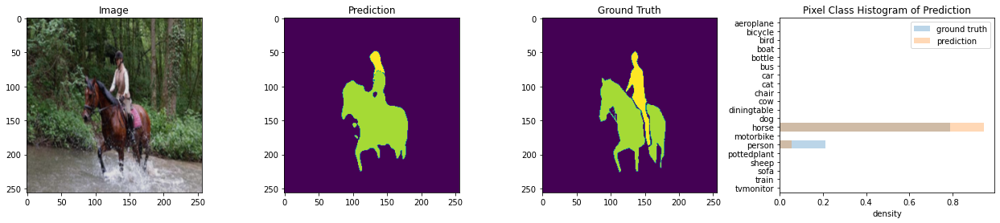

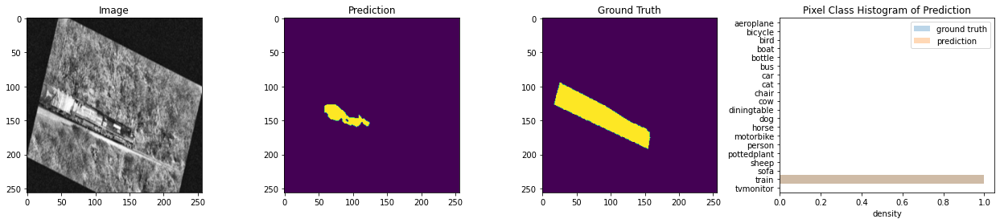

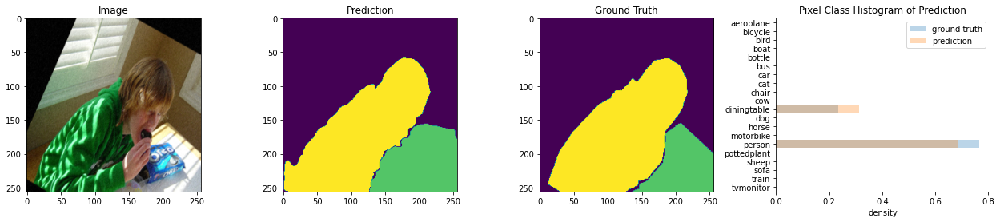

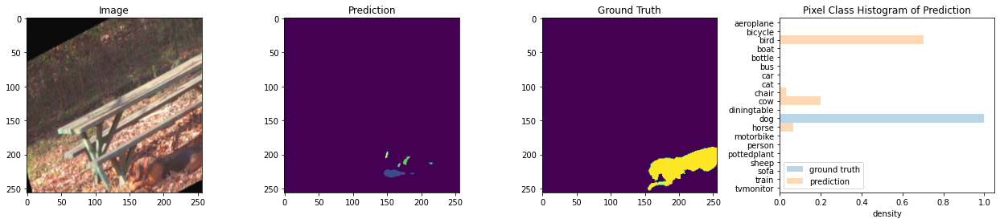

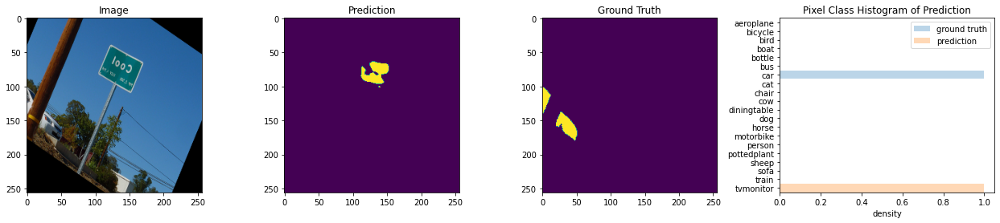

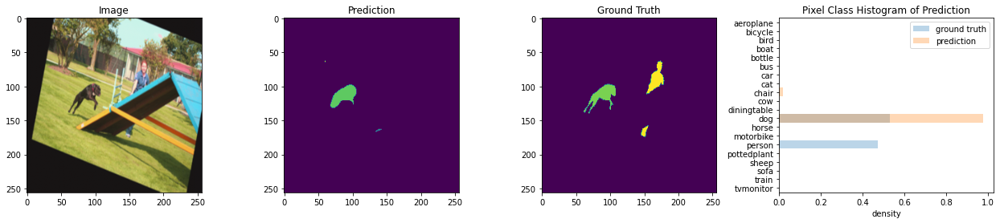

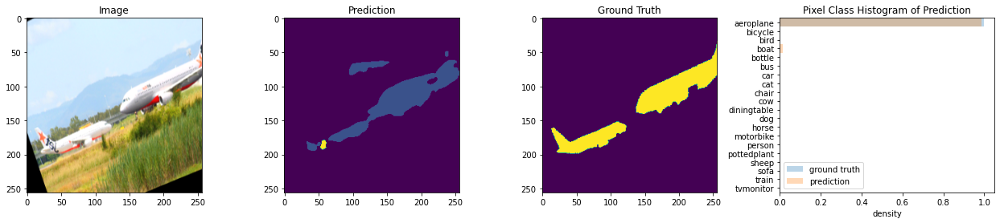

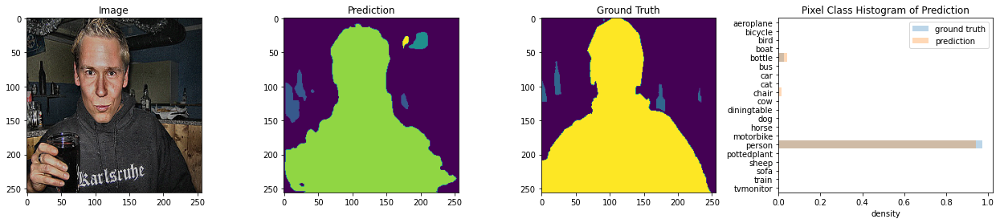

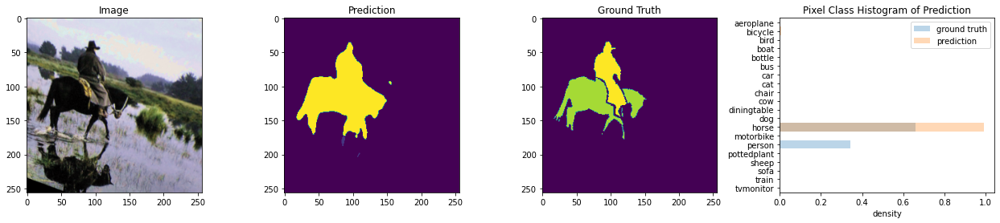

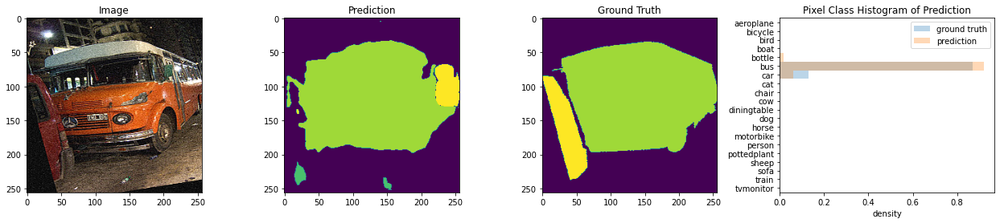

In [67]:
visualize_examples(model, ds_train, n=10)

Predicted:  ['bg', 'bird', 'sheep']
True:  ['bg', 'bird']


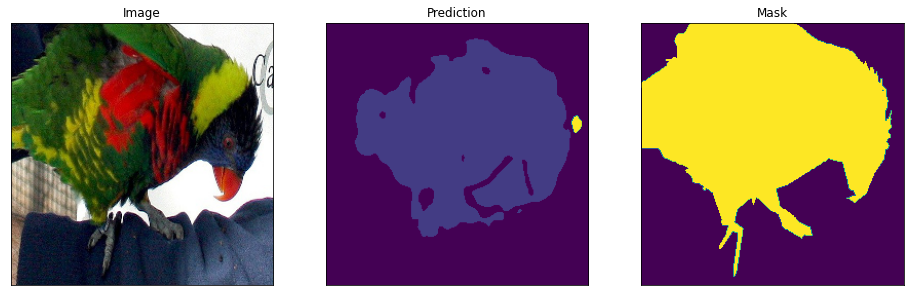

Predicted:  ['bg', 'dog', 'horse']
True:  ['bg', 'horse']


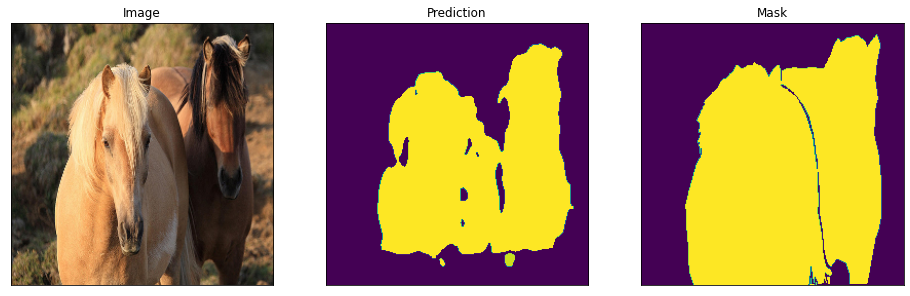

Predicted:  ['bg', 'horse']
True:  ['bg', 'horse']


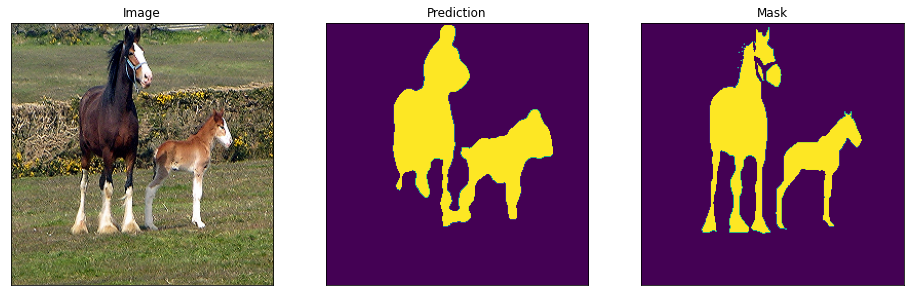

Predicted:  ['bg', 'bicycle', 'person']
True:  ['bg', 'bicycle', 'car', 'person']


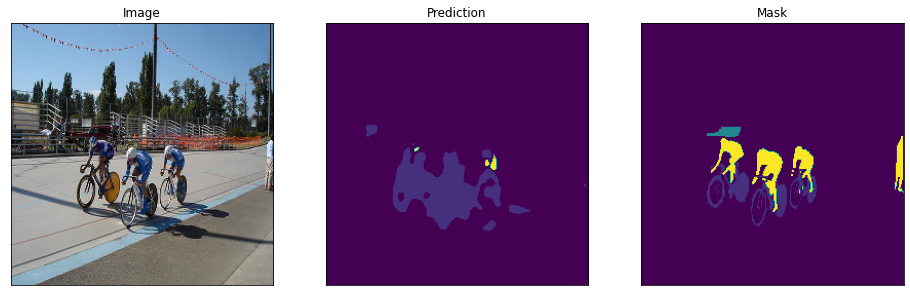

Predicted:  ['bg', 'cat', 'dog', 'person']
True:  ['bg', 'dog', 'person']


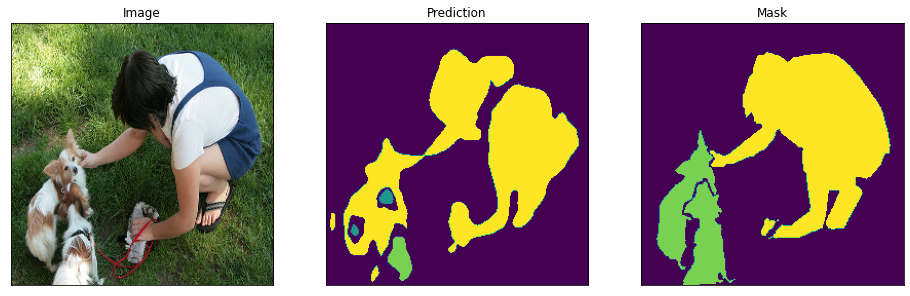

In [68]:
valid_dataloader = Dataloader(ds_val, batch_size=1, shuffle=False)
for ind in range(20,25):
    pred = model.predict(valid_dataloader[ind][0])
    # pred = np.round(pred)
    pred [pred<0.7]=0
    pred [pred>=0.7]=1
    print('Predicted: ', CAT_LIST_SEG_arr[np.unique(np.argmax(pred.squeeze(),axis=2))].tolist())
    print('True: ',CAT_LIST_SEG_arr[np.unique(np.argmax(valid_dataloader[ind][1].squeeze(),axis=2))].tolist())
    visualize(
        image = valid_dataloader[ind][0].squeeze(),
        prediction = np.argmax(pred.squeeze(),axis=2),
        mask = np.argmax(valid_dataloader[ind][1].squeeze(),axis=2),
    )

In [69]:
ds_test = Dataset(test_X, np.zeros((750,224,224), dtype=int), preprocessing=preprocess_dataset )
test_dataloader = Dataloader(ds_test, batch_size=1, shuffle=False)

### Check some qualitative results for Segmentation

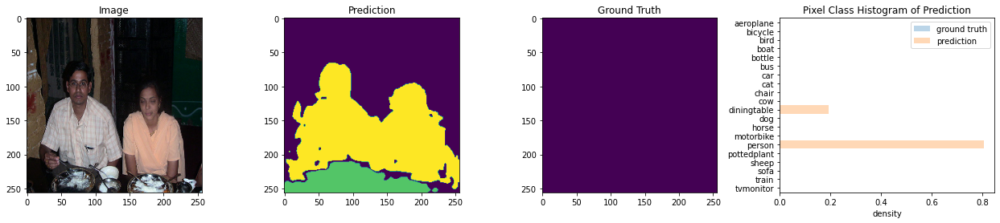

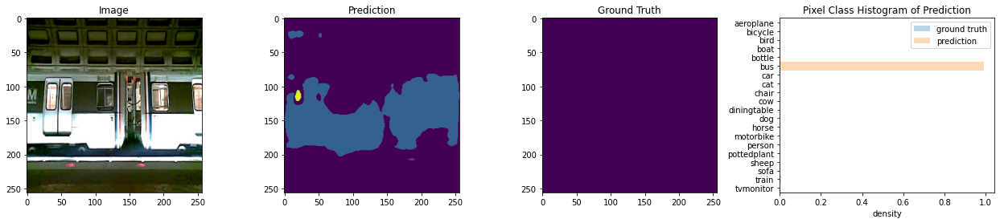

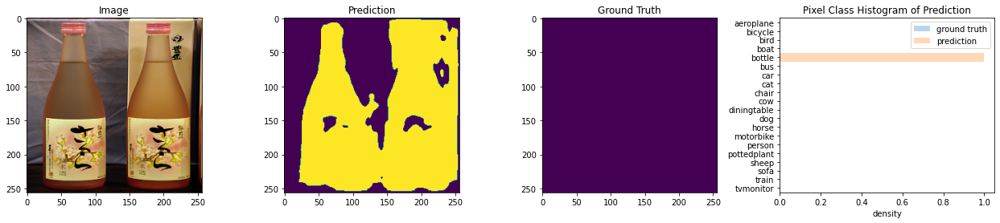

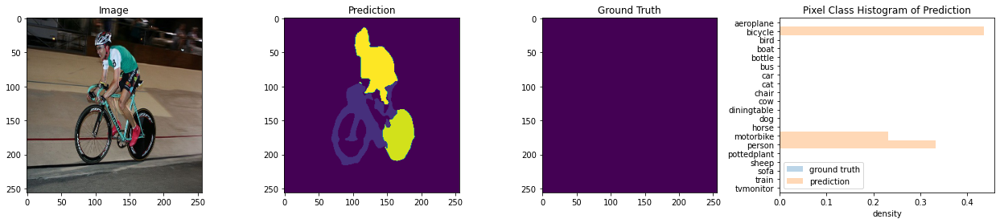

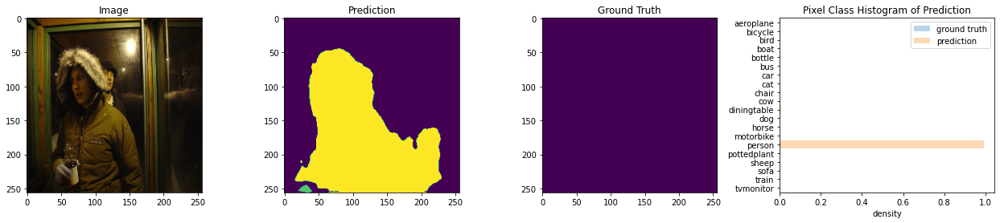

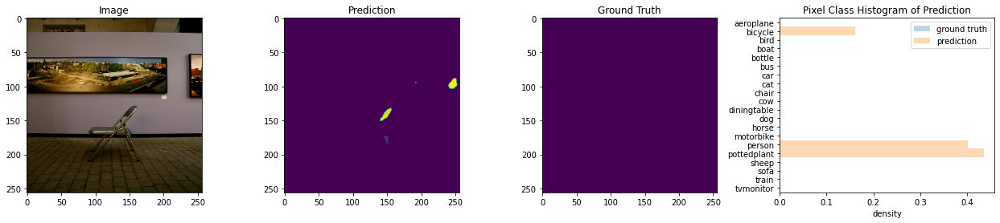

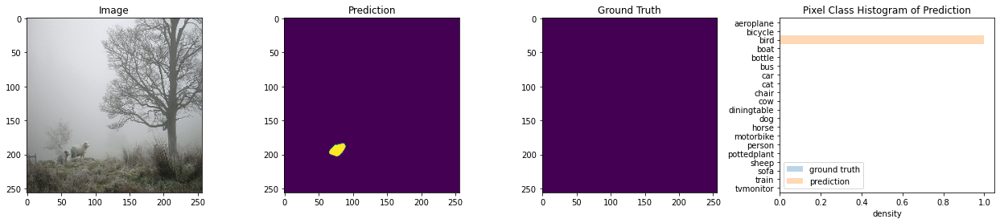

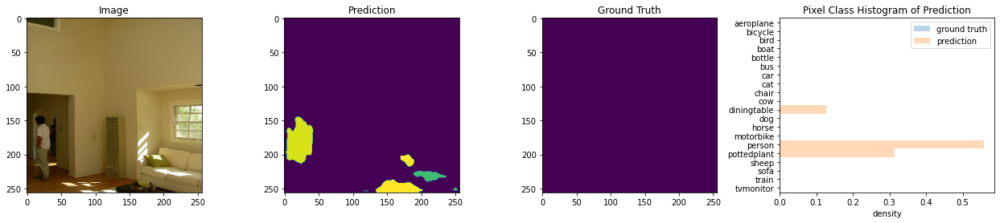

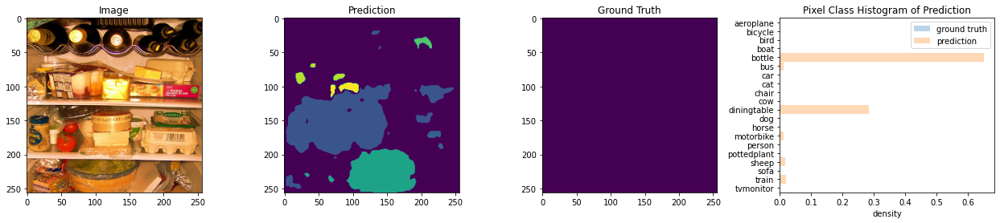

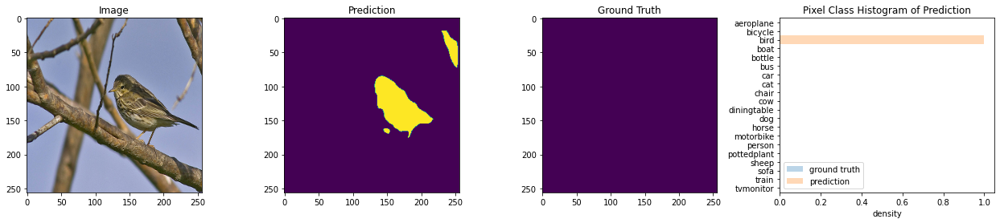

In [70]:
visualize_examples(model, ds_test, n=10)

In [71]:
h,w,_ = test_df["img"].loc[i].shape
h,w

(375, 500)

In [72]:
tmp = []
for ind in range(test_X.shape[0]):
    pred = model.predict(test_dataloader[ind][0])
    pred[pred<0.7] = 0
    pred[pred>=0.7] = 1
    h,w,_ = test_df["img"].loc[ind].shape
    temp = np.argmax(pred.squeeze(),axis=2)
    pred = cv2.resize(temp.astype(np.uint8), (w,h))
    tmp.append(pred)
test_df.loc[:]['seg'] = tmp

### Discussion
In this section we used the FPN architecture with pretrained encoder InceptionV3 on Imagenet. The network achieved significantly better results in terms of 𝐼𝑜𝑈 scores, as indicated by the qualitative plots above. This model also had the best perfomance using the RLE encoding for the Kaggle competition.

## Submit to competition


In [73]:
generate_submission(test_df)

,Predicted
Id,
0_classification,15 1 20 1
0_segmentation,15036 2 15535 1 15538 1 16040 1 16534 1 16541 ...
1_classification,9 1 11 1 18 1
1_segmentation,50698 1 53180 1 53204 1 54677 1 54707 1 55710 ...
2_classification,9 1 18 1
...,...
747_segmentation,23124 4 23623 1 23628 1 24120 1 24129 1 24618 ...
748_classification,11 1 15 1
748_segmentation,52043 6 53538 1 53559 3 54535 1 55067 1 62037 ...


# 4. Adversarial attack
In the final section, the goal is to create a $GAN$ (encoder-decoder CNN) which adds pertubation to instances of the original VOC dataset. Our goal is to add visibly hidden noise to some original images that belong to a specific class, in order to fool our original classification network presented on _section 1_. 

### 4.1 Simple White-box Adversarial Attack
Our first approach of adversarial attacks involves choosing a specific class as a target and trying to purturb any image towards being missclassified as that target class. This is accomplished by using a **Categorical Crossentropy** loss between the prediction of our finetuned classifier and the desired prediction for the target class. The gradient of the loss is stored in a perturbation image $delta~(δ)$, which is optimized in a loop so that when added to the original image the classifier outputs the desired predictions. A parameter ε controls the maximum amount of perturbation per pixel and acts as a **regularization parameter** for performing a minimal perturbation that is not visible to the naked eye and looks exactly like the original image.

In [74]:
import tensorflow as tf
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow import keras


def clip_eps(tensor, eps):
    # clip the values of the tensor to a given range and return it
    return tf.clip_by_value(tensor, clip_value_min=-eps, clip_value_max=eps)

def generate_adversaries(model, base_image, delta, target_class, num_classes, steps=50, lr=1e-1, eps=2.0/255):
    sccLoss = tf.keras.losses.CategoricalCrossentropy(from_logits=False)
    optimizer = Adam(learning_rate=lr)
    target = tf.expand_dims(tf.one_hot(target_class, num_classes), axis=0)
    done_count = 0

    for step in range(0, steps):
        # record our gradients
        with tf.GradientTape() as tape:
            # track perturbation matrix for gradient updates
            tape.watch(delta)
            # add our perturbation image to the base image and preprocess
            adversary = preprocess_input(base_image + delta)
            # predict class of perturbed image
            predictions = model(adversary, training=False)
            # calculate loss between prediction from target class
            loss = sccLoss(target, predictions)
            # print current state
            if step % 1 == 0:
                print("step: {}, loss: {}, prediction: {}".format(step, loss, tf.argmax(tf.squeeze(predictions))))

        # calculate loss gradients
        gradients = tape.gradient(loss, delta)
        # update the weights of the perturbation image
        optimizer.apply_gradients([(gradients, delta)])
        # clip perturbation image
        delta.assign_add(clip_eps(delta, eps=eps))

        if np.argmax(tf.squeeze(predictions)) == target_class and loss < 1e5:
            break

    # return the perturbation vector
    return delta


def adversarial_attack(model, image, target_class, classes, lr=1, steps=50, eps_list=[0.1]):
    for eps in eps_list:

        # convert input image to tensor
        base_image = tf.constant(np.expand_dims(image, 0), dtype=tf.float64)

        # generate adversarial attack pattern
        delta = tf.Variable(tf.zeros_like(base_image), trainable=True)
        new_delta = generate_adversaries(classifier, base_image, delta, target_class, len(classes), steps=steps, lr=lr, eps=eps)

        # perturb original image
        adversary = (base_image + new_delta).numpy().squeeze()
        # clip to range 0-255
        adversary = np.clip(adversary, 0, 255).astype("uint8")
        # convert to BGR
        adversary = cv2.cvtColor(adversary, cv2.COLOR_RGB2BGR)
        # convert to numpy array
        new_delta = new_delta.numpy().squeeze()

        actual_label = np.argmax(model.predict(base_image))
        adv_label = np.argmax(classifier.predict(np.expand_dims(adversary, 0)))
        print(f'Actual label: {actual_label} == {CAT_LIST[actual_label]}')
        print(f'Adversarial label: {adv_label} == {CAT_LIST[adv_label]}')

        # display image, perturbed image, perturbation, perturbation histogram
        fig, ax = plt.subplots(1, 4, figsize=(25,5))
        ax[0].imshow(image, label='original image'); ax[0].axis('off'); ax[0].set_title(f'Original Image classified as "{CAT_LIST[actual_label]}"')
        ax[1].imshow(cv2.cvtColor(adversary, cv2.COLOR_BGR2RGB)); ax[1].axis('off'); ax[1].set_title(f'Perturbed Image classified as "{CAT_LIST[adv_label]}"')
        ax[2].imshow(new_delta-new_delta.min()); ax[2].axis('off'); ax[2].set_title('Perturbation')
        ax[3].hist(new_delta.ravel(), density=True); ax[3].set_title('Histogram of perturbation pixel values'); ax[3].set_xlabel('intensity'); ax[3].set_ylabel('percentage')
        plt.show()

#### Examples of adversarial attacks
Now we will perform some adversarial attacks on some images from the test set to perturb them so that they are missclassified as `bicyle`. The first image in particular is an image of a `bicycle` that is used as a sanity check to make sure that it is not perturbed by our algorithm. The rest of the images were picked randomly in order to showcase how our algorithm perturbs them so that they are missclassified as `bicycles`.

step: 0, loss: 7.986990567587782e-06, prediction: 1
Actual label: 17 == sofa
Adversarial label: 17 == sofa


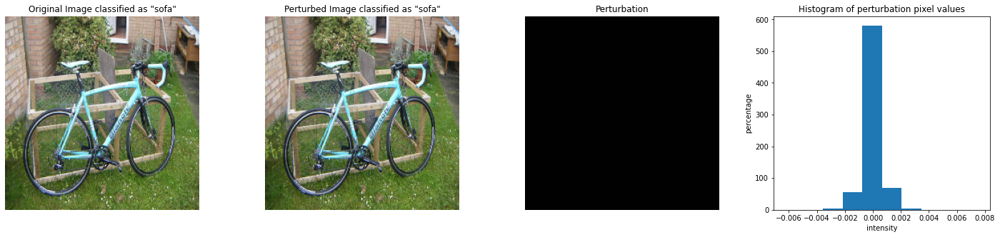

step: 0, loss: 3.9164364337921143, prediction: 14
step: 1, loss: 0.12988883256912231, prediction: 1
Actual label: 14 == person
Adversarial label: 1 == bicycle


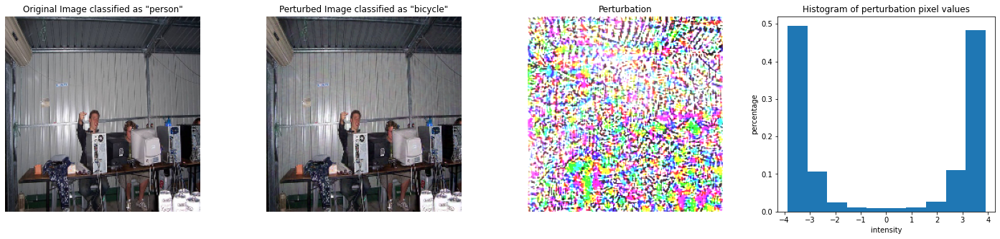

step: 0, loss: 4.743399620056152, prediction: 8
step: 1, loss: 0.051831796765327454, prediction: 1
Actual label: 8 == chair
Adversarial label: 1 == bicycle


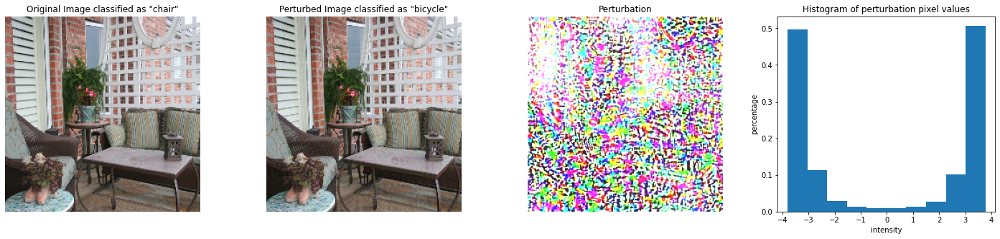

step: 0, loss: 21.198152542114258, prediction: 7
step: 1, loss: 5.838628768920898, prediction: 2
step: 2, loss: 0.8213327527046204, prediction: 1
Actual label: 7 == cat
Adversarial label: 1 == bicycle


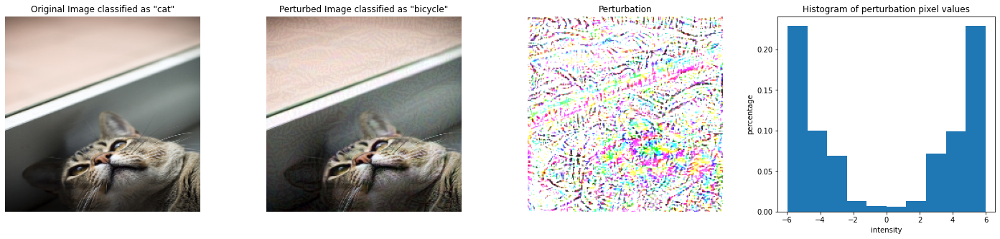

step: 0, loss: 16.641864776611328, prediction: 5
step: 1, loss: 0.5608779191970825, prediction: 1
Actual label: 5 == bus
Adversarial label: 1 == bicycle


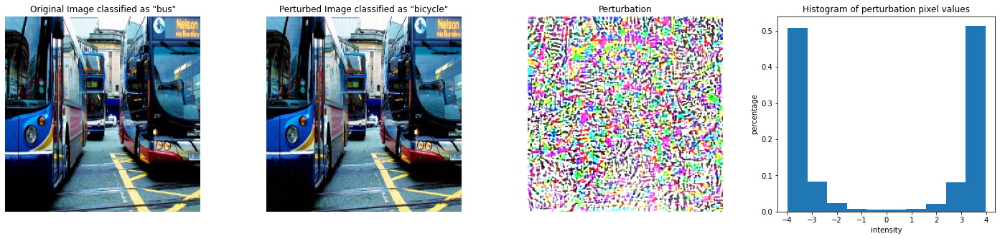

step: 0, loss: 7.962744235992432, prediction: 14
step: 1, loss: 1.9084315299987793, prediction: 14
step: 2, loss: 0.17710891366004944, prediction: 1
Actual label: 14 == person
Adversarial label: 14 == person


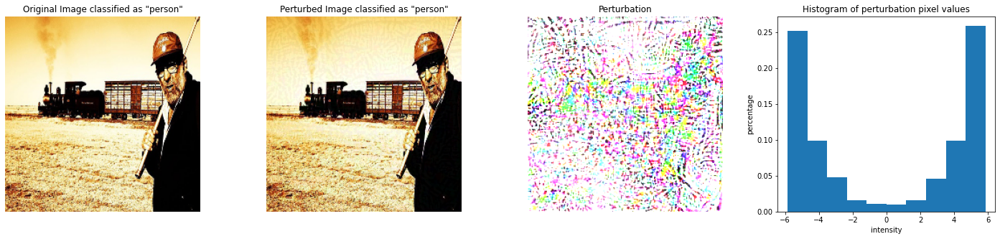

step: 0, loss: 19.002056121826172, prediction: 12
step: 1, loss: 3.9136734008789062, prediction: 11
step: 2, loss: 0.6806444525718689, prediction: 1
Actual label: 12 == horse
Adversarial label: 14 == person


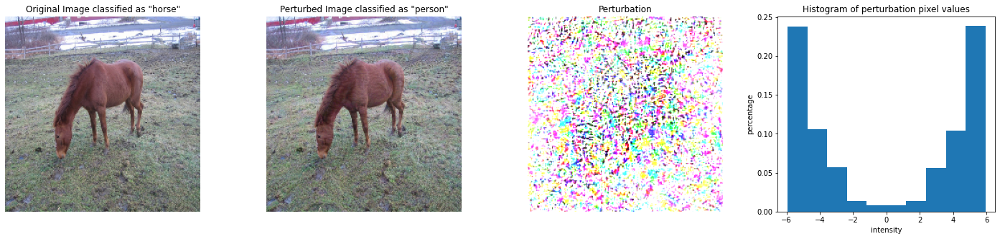

In [75]:
# load our finetuned VGG16 model
classifier = keras.models.load_model('vgg16_ft')

# perform some adversarial attacks for demonstrative purposes
for idx in [31, 0, 1, 12, 17, 8, 11]:
    image = test_X_arr[idx]
    target_class = CAT_LIST.index('bicycle')
    adversarial_attack(classifier, image, target_class, CAT_LIST, lr=1, steps=50, eps_list=[1])

### 4.2 Conditional Generative Adversarial Net
This approach is based on the work of Yu et al., titled _"Generating Adversarial Examples With Conditional Generative Adversarial Net"_, ICPR Beijing, 2018 [[source](https://arxiv.org/ftp/arxiv/papers/1903/1903.07282.pdf)]. This time, our goal is to pick 2 different classes that are fairly similar to each other, and generate perturbation images that fool our initial classification model. In order to achieve this, we remove all other images from the original dataset.

In the paper mentioned above, there is an extensive analysis of misclassification with targeted attacks. Once again, in order to limit the influence of the pertubation on the original image, the norm of the **pertubation** is restricted to a maximal values for each color channel (more on that later).

### Load fine-tuned classification model
First, we load our classification model presented above. In order to trick our model, we decide to choose two similar classes and remove the rest. We pick classes `'cow'` (index 9) and `'sheep'` (index 16), since they comprise animals with fairly similar features. Then, we remove the final classification layer and only keep the weights corresponding to these 2 classes, building our new discriminator model.

In [76]:
import tensorflow as tf
clf_model = keras.models.load_model('vgg16_ft')                           # load custom cls model

metrics_tmp = [ keras.metrics.BinaryAccuracy(name='binary_accuracy'),     # use the following metrics
          keras.metrics.AUC(name='auc'),
          keras.metrics.AUC(name='prc', curve='PR'),
          precision_custom,
          recall_custom,
          f1_custom
        ]

clf_layer = clf_model.layers[-1].output                                   # remove classification layer
bin_clf_layer = tf.gather(clf_layer,[9,16],axis=-1)                       # keep olny weights corrsponding to the correct indices
discriminator = Model(clf_model.input,bin_clf_layer)                      # build new model with the correct Input, output
discriminator.trainable = False                                           # Freeze layers of discriminator

### Switching labels
Now we reduce the dataset to only contain images of the two chosen classes. We swap the labels of cows and sheeps, in order to be able to generate the correct perturbation. Another option would be to do this in the loss function when training the pertubation model. 

In [77]:
# Create cow dataframe with target output '0'
cow_df = train_df[train_df['cow']==1]['img']
cow_df = cow_df.to_frame()
cow_df['labels'] = 1            # switch it

# Create sheep dataframe with target output '1'
sheep_df = train_df[train_df['sheep']==1]['img']
sheep_df = sheep_df.to_frame()
sheep_df['labels'] = 0          # switch it

temp = cow_df.append(sheep_df)  # append the two dataframes

In [78]:
# Just split train and test dataset
train_X_list = [cv2.resize(temp.loc[i]["img"], (224, 224)) for i in temp.index]
train_X_arr = np.stack(train_X_list, axis=0)
train_X, test_X, train_y, test_y = train_test_split(train_X_arr, temp['labels'], test_size=0.12, random_state=12)

The network comprises several conv layers which convert the input image down to a $256$-dimensional feature vector. Finally, the generated pertubation is rescaled to the image's orgiginal dimensions, mostly in order to make sure that it is as close to the original image as possible. This is done by specifying a ```max_norm``` parameter that does the clipping, similarly to before. This way, the norm of the pertubation is restricted/ limited in order to generate visibly hidden perturbation.

The following implementation uses the `inf norm`, which means that the maximum value of the pertubation in any color channel will not exceed the value of ```max_norm```.


In [79]:
# Make some imports
from keras.layers import Conv2DTranspose
from keras.layers import ReLU
from keras.layers import Add

In [80]:
def block(prev_layer,filters):
  """Typical building block"""
  res_layer1 = Conv2D(filters=filters, kernel_size=(3,3), strides=(1,1), padding="same", activation="relu")(prev_layer)
  res_layer2 = Conv2D(filters=filters, kernel_size=(3,3), strides=(1,1),padding="same", activation="relu")(res_layer1)
  return Add()([prev_layer, res_layer2])


def get_resnet_generator(max_norm=None, ord=2, batch_size=1):
  """Build a ResNet generator"""
  input_shape = (224, 224, 3)
  input_generator = Input(shape=input_shape)

  # Building the encoder
  conv1 = Conv2D(filters=64, kernel_size=(7,7), strides=(1,1), padding="same", activation="relu")(input_generator)
  conv2 = Conv2D(filters=128, kernel_size=(3,3), strides=(2,2), padding="same", activation="relu")(conv1)
  conv3 = Conv2D(filters=256, kernel_size=(3,3), strides=(2,2), padding="same", activation="relu")(conv2)

  # Building the transformer
  res1 = block(conv3, filters=256)
  res2 = block(res1, filters=256)
  res3 = block(res2, filters=256)
  res4 = block(res3, filters=256)
  res5 = block(res4, filters=256)
  res6 = block(res5, filters=256)

  # Building decoder
  deconv1 = Conv2DTranspose(filters=128, kernel_size=(3,3), strides=(2,2), padding="same", activation="relu")(res6)
  deconv2 = Conv2DTranspose(filters=256, kernel_size=(3,3), strides=(2,2), padding="same", activation="relu")(deconv1)
  out = Conv2DTranspose(filters=3, kernel_size=(3,3), strides=(1,1), padding="same", activation="relu")(deconv2)
  
  # Rescaling images
  rescaled_batch = []
  tiling = tf.convert_to_tensor([input_shape[0]])
  orders = [tf.constant([0,1,1],dtype=tf.float32),tf.constant([1,0,1],dtype=tf.float32),tf.constant([1,1,0],dtype=tf.float32)]
  masks = []
  for order in orders:
    masks.append(tf.reshape(tf.tile(tf.tile(order,tiling),tiling), input_shape))

  for i in range(batch_size):
    try:
      rescaled_img = out[i]
      rescaled_img +=1
      rescaled_img *= 127.5
      for ci in range(3):
        mask = masks[ci]
        l_inf = tf.norm(rescaled_img[:,:,ci],ord=ord)
        rescaled_img = rescaled_img * mask + rescaled_img * tf.minimum(tf.cast(1,tf.float32),max_norm / l_inf) * (1 - mask)
      
      rescaled_img /= 127.5
      rescaled_img -= 1
      rescaled_batch.append(rescaled_img)
    except :
      break
  rescale = tf.stack(rescaled_batch)

  # Rescale image back to [0,1])
  adding = Add()([(input_generator + 1) / 2,(rescale + 1) / 2])
  adding *= 2
  adding -= 1

  #Clipping the final image to values interval [-1,1]
  clipping = tf.clip_by_value(adding,-1,1)
  
  return input_generator, clipping, rescale

In [81]:
from tensorflow.keras.utils import to_categorical
train_datagen = ImageDataGenerator(rescale=1./255)      # simply rescale imput to [0,1]

gen_train = train_datagen.flow(np.array(train_X), to_categorical(train_y), batch_size=10)
gen_test = train_datagen.flow(np.array(test_X), to_categorical(test_y), batch_size=7)

### Training GAN
Use the train generator in order to train the $GAN$ model. The test generator can be later used in order to check results on images that the trained model has never seen before.

In [82]:
from keras.losses import BinaryCrossentropy

input_generator_train, output_generator_train, rescale = get_resnet_generator(max_norm=10, ord=np.inf, batch_size=10)
output_train = discriminator(output_generator_train)        # get output of classification network

gan_model = Model(input_generator_train, output_train)      # build the model
gan_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002),         # compile it using the parameters mentioned in the paper
                                loss=BinaryCrossentropy(),
                                metrics=metrics_tmp)

In [83]:
train_X.shape     # check the input shape

(50, 224, 224, 3)

In [84]:
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath='gan_weights.h5',
                                                          save_weights_only=True,
                                                          monitor='loss',
                                                          mode='min',
                                                          save_best_only=True)

# gan_model.fit(gen_train, epochs=1200, callbacks=[checkpoint_callback])

## Donwload already trained GAN model (optional) 

In [85]:
!gdown https://drive.google.com/uc?id=1MRPIz3e3ZcAyjN9E6uB4tdPO1biWvJoy    # download gan model
# !unzip -q gan_model.h5.zip
# !rm -rf gan_model.h5.zip

Downloading...
From: https://drive.google.com/uc?id=1MRPIz3e3ZcAyjN9E6uB4tdPO1biWvJoy
To: /kaggle/working/gan_weights.h5
93.7MB [00:00, 152MB/s]


In [86]:
gan_model.load_weights('/kaggle/working/gan_weights.h5')

In [87]:
print(gan_model.evaluate(gen_train))

5/5 [==============================] - 23s 3s/step - loss: 1.5557 - binary_accuracy: 0.5961 - auc: 0.5307 - prc: 0.6362 - precision_custom: 0.3389 - recall_custom: 0.3158 - f1_custom: 0.3268
[0.9736114740371704, 0.7300000190734863, 0.7374000549316406, 0.8087239861488342, 0.6000000238418579, 0.5600000023841858, 0.5789473652839661]


### Results of Attacks
Here we examine the results achieved by our generated model

In [88]:
pertubation_model = Model(input_generator_train, output_generator_train)      # create new noise model
noise_model = Model(input_generator_train, rescale)                           # create new perturbation model

In [89]:
def postprocess(img):
  """Use this function to showcase perturbation in better colors"""
  img_c = np.copy(img)
  img_c += 1
  img_c /= 3
  return img_c*3

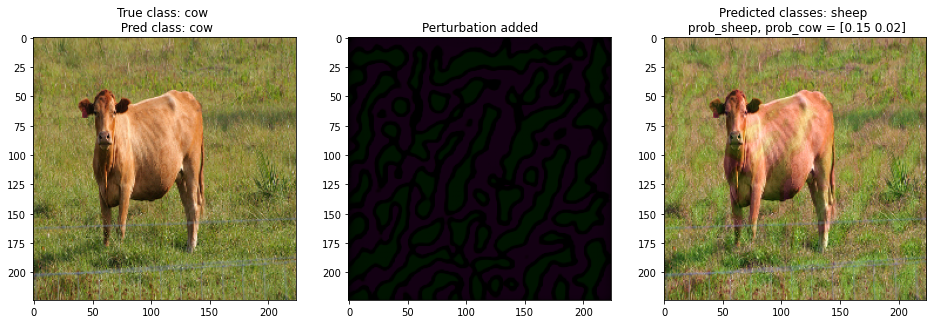

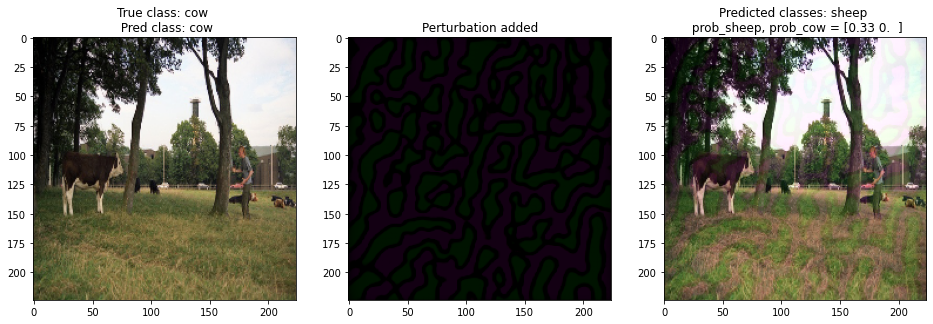

In [90]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
classes = np.array(['sheep', 'cow'])

batch_nr = 4
img_ind = [2,8]

for ind in img_ind:
  fix,ax = plt.subplots(1,3,figsize=(16,5))
  img = gen_train[batch_nr][0][ind]
  img_dims = (img.shape[1],img.shape[0])


  orig_pred = discriminator.predict(gen_train[batch_nr][0])[ind]
  orig_pred_cls = "cow" if orig_pred[0] > orig_pred[1] else "sheep"

  ax[0].imshow(img)
  t = ax[0].set_title(f"True class: {classes[gen_train[batch_nr][1][ind] == 1][0]} \n Pred class: {orig_pred_cls}")

  # Plot pertubation
  noise_out = noise_model.predict(gen_train[batch_nr][0])[ind]
  #   noise_out = (noise_out - noise_out.min())/(noise_out.max() - noise_out.min()) 
  ax[1].imshow(postprocess(noise_out))
  t = ax[1].set_title("Perturbation added")

  
  #Predictions of pertubated image
  pertubated = pertubation_model.predict(gen_train[batch_nr][0])[ind]
  pred = discriminator.predict(gen_train[batch_nr][0])[ind]
  false_pred = "cow" if pred[0] < pred[1] else "sheep"

  ax[2].imshow(pertubated)
  t = ax[2].set_title(f"Predicted classes: {false_pred} \n prob_sheep, prob_cow = {pred.round(2)}")
  plt.show()

In [91]:
def repeat(img, n):
  """Repeat one image for a whole batch"""
  out = np.zeros([n,img.shape[0],img.shape[1],img.shape[2]])
  for i in range(n):
    out[i] = img
  return out

### Check results for test data

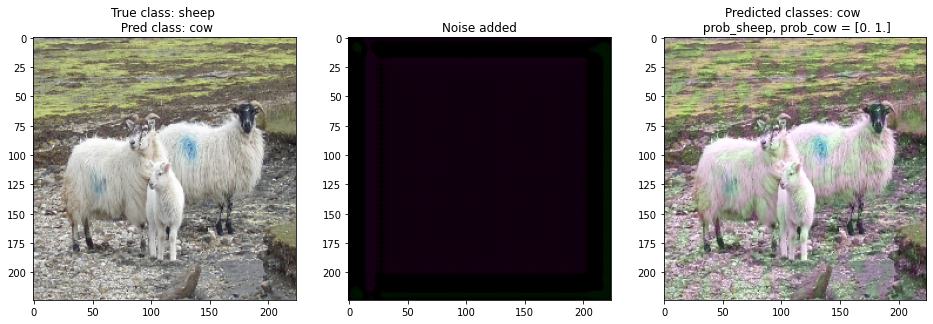

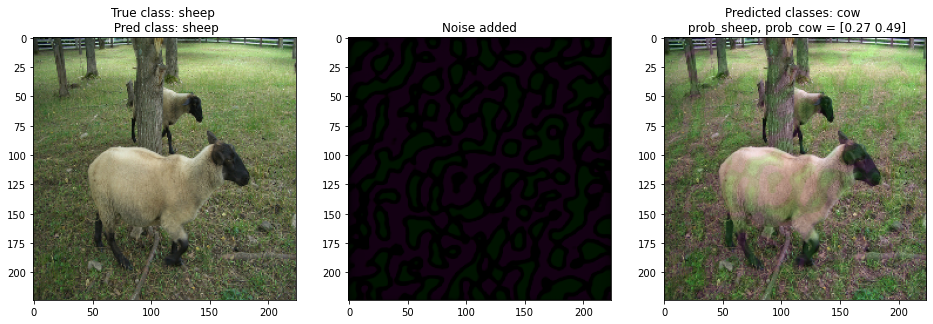

In [92]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
classes = np.array(['sheep', 'cow'])

batch_nr = 0
img_ind = [3,4]

for ind in img_ind:
  fix,ax = plt.subplots(1,3,figsize=(16,5))
  img = gen_test[batch_nr][0][ind]
  img_dims = (img.shape[1],img.shape[0])


  orig_pred = discriminator.predict(gen_test[batch_nr][0])[ind]
  orig_pred_cls = "cow" if orig_pred[0] > orig_pred[1] else "sheep"

  ax[0].imshow(img)
  t = ax[0].set_title(f"True class: {classes[gen_test[batch_nr][1][ind] == 1][0]} \n Pred class: {orig_pred_cls}")

  # Plot pertubation
  img1 = gen_test[batch_nr][0][ind]
  noise_out = noise_model.predict(repeat(img1, 10))[0]
#   noise_out = (noise_out - noise_out.min())/(noise_out.max() - noise_out.min()) 
  ax[1].imshow(postprocess(noise_out))
  t = ax[1].set_title("Noise added")
  
  #Predictions of pertubated image
  pertubated = pertubation_model.predict(repeat(img1, 10))[0]
  pred = discriminator.predict(repeat(img1, 10))[0]
  false_pred = "cow" if pred[0] < pred[1] else "sheep"

  ax[2].imshow(pertubated)
  t = ax[2].set_title(f"Predicted classes: {false_pred} \n prob_sheep, prob_cow = {pred.round(2)}")
  plt.show()

# 5. Conclusion
## Classification Task
In the classification section of this project we examine the use of custom classification models and models with pretrained weights based on transfer learning. The results of all tested custom models based on `VGG16` were heavily biased against the `person` class, despite the class weights, regularization utilization, data augmentation we tried. This is most probably due to the fact that the training data instances are far too few in order to train a custom model from scratch, no matter how much **augmentation** is used. The **transfer learning** models did significantly better, as examined by the presented quantitative and qualitative results. We also note here that the **convergence** of the transfer learning methods was much faster in all cases, since they utilized pre-trained weights on large image datasets. More experimentation on this task can be done by using different architectures, adding more layers to the current ones, and trying different training parameters (eg. optimizer, learning rate, loss function etc).

## Semantic segmentation Task

The main idea behind semantic segmentation is detecting pixel-level labels of objects that exist in the image. With the rise of **Deep Learning** models and architectures in recent years, modern architectures have been able to surpass the previous state-of-the-art traditional methods. 

Just like before, we created our own custom segmentation model using the `UNet` architecture, which performed quite well on the training and validation sets, but performed quite poorly on the test set. This may be due to overfitting because of the limited amount of instances in the provided dataset. Moreover, this task is considered to be far more challenging than the classification task due to the complexity of predicting multiple labels (pixel-level) vs predicting only image-level labels. After utilizing transfer learning with the `FPN` architecture and an `inceptionv3` encoder, we managed to get much better results. Although the results improved considerably, our approach seemed to be lacking considering the scores of other teams in the kaggle competition, as well as the state-of-the-art methods that achieve much better performance metrics. 

## Steps for improvement


Most options towards the improvement of performance of the classification and segmantation models were examined, namely choice of models, data augmentations, tuning hyperparameters etc. Indeed, these approaches boosted the perfomance up to a certain point. However, in machine learning there is a saying; there is no better data than more data!, and it turns out in our case the limited number of training examples/instances is restrictive. Using the complete PASCAL VOC2009 or VOC2012 dataset or even pretraining the model on a dataset with same classes ( i.e. COCO) could help alleviate this issue.
In order to improve performance, we also examined the use of one of the leading architectures in classification - segmentation tasks: `Mask-RCNN`. `Mask-RCNN` pretrained on COCO can already produce exceptional results out of the box. We also examined training the model on the 20 classes of VOC2009 given the provided dataset and finetuning it for 40 epochs. This understandably gave similar results, but we considered it as not fair-game for the kaggle competition, since it required minimal effort.

## Adversarial Attack on Classification Model

Adversarial attacks are methods for fooling neural networks by perturbing their images in a way that they cause the network to missclassify them without a noticeable difference upon visual inspection by people. We experimented with two approaches as a means to perform white-box adversarial attacks on one of our classification models. The first simpler gradient-based approach succeeded in most cases to perturb the input images enough so that they are missclassified as the chosen bicycle class, while not showing any distinctive difference to the naked eye. 

The second approach involved training a `Conditional Generative Adversarial Network` for generating perturbation images that fool our classification model. For the second experiment we selected two classes that were similar, namely sheep and cow, and generated perturbation images to fool the classifier into labelling one as the other and vice versa. This selection was based on the fact that it was easier for the network to succeed when trying to fool the classifier with two similar classes, rather than two widely different ones. The training process of the model was expensive both on time and computational resources (approx. 5 hours for 1650 epochs), which was an additional reason we decided to change the problem to a binary classification. We also note that the loss during training kept a decreasing trend even after reaching the maximum number of epochs, which means that one could also increase that parameter (i.e. above 2000 epochs). The generated pertubations seem to achieve their purpose, meaning that they introduce weak noise to the final image which is unnoticable to human-eye but able to fool the classifier in many cases.